In [1]:
import xarray as xr
import numpy as np
import numpy as np
import xarray as xr
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd

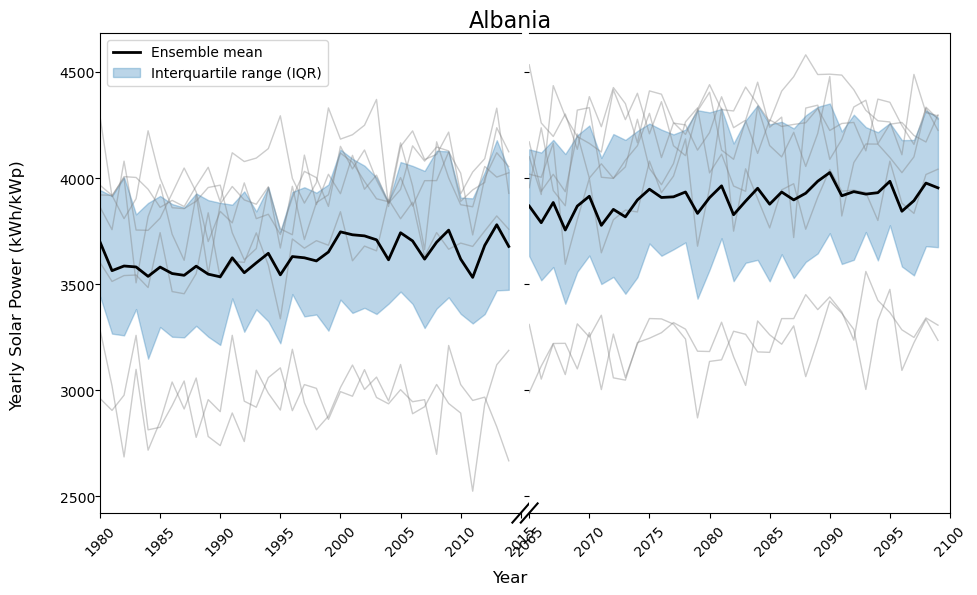

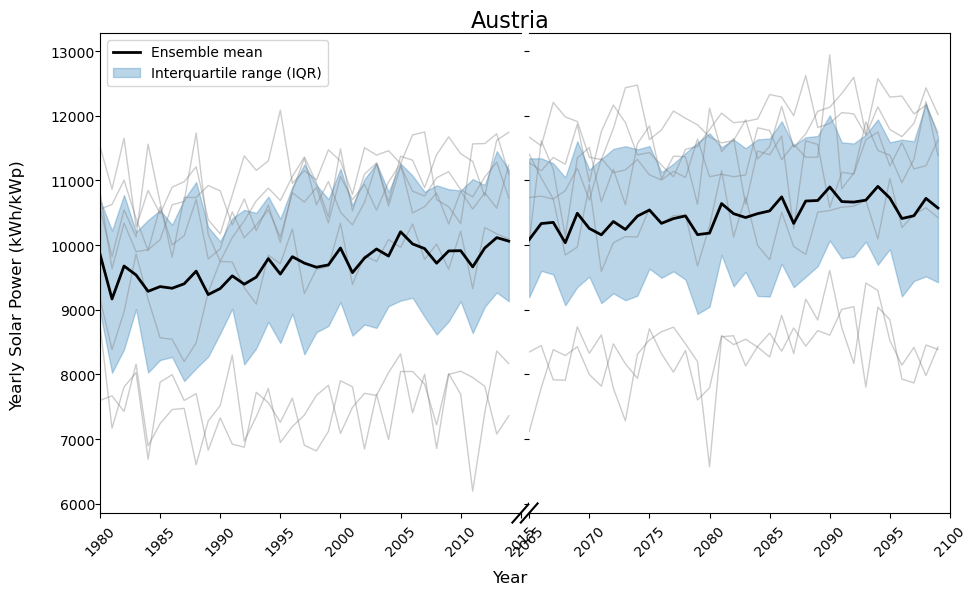

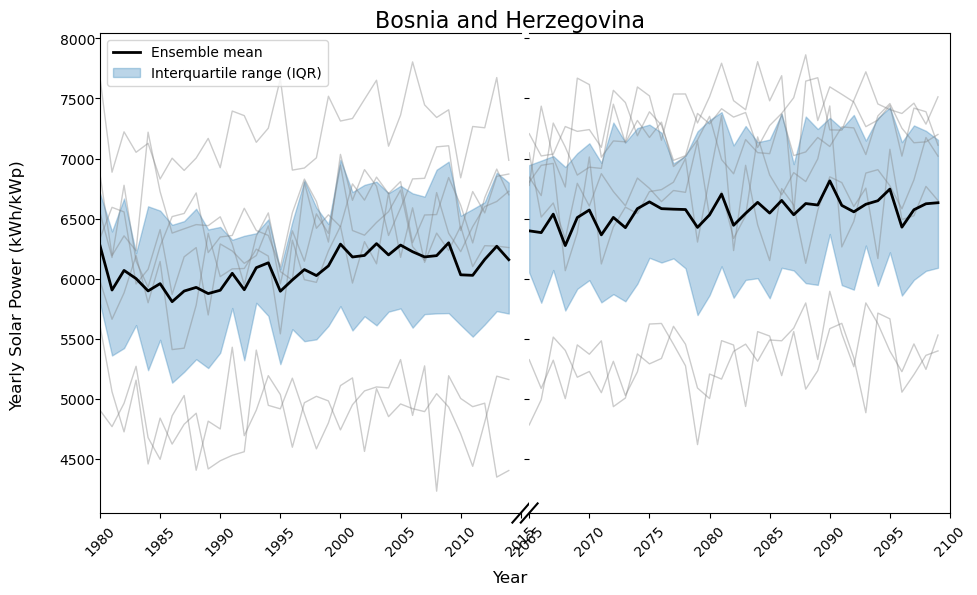

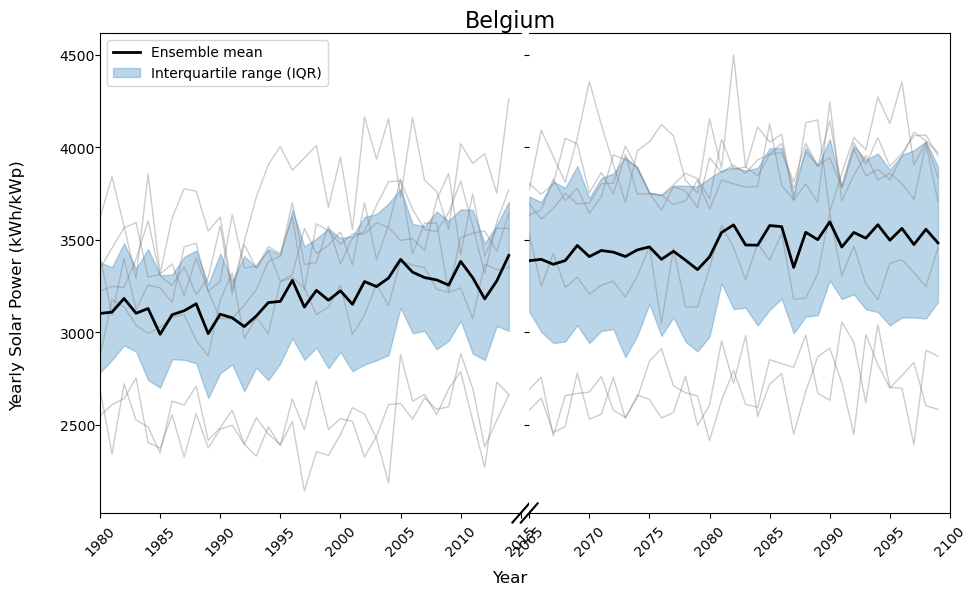

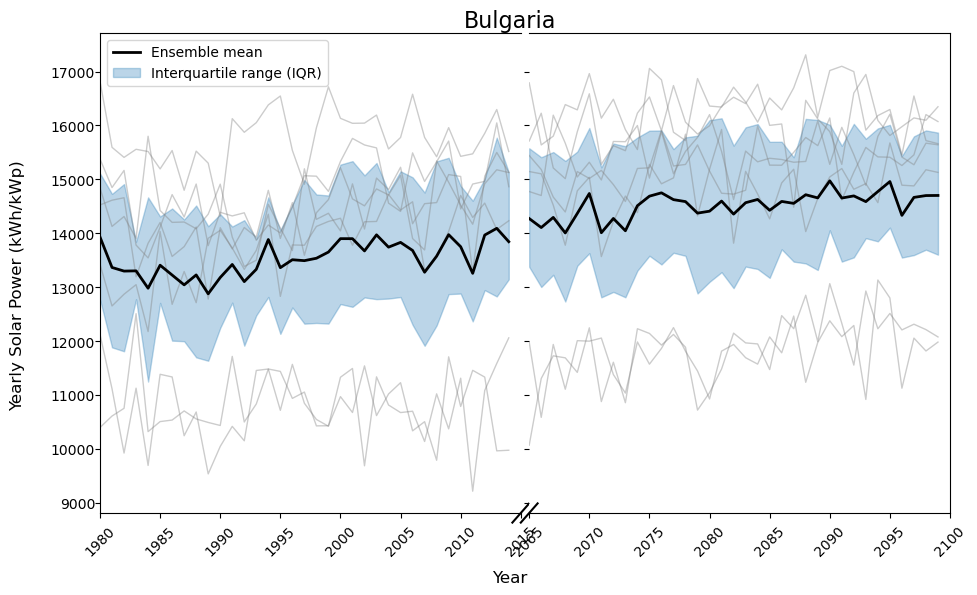

...

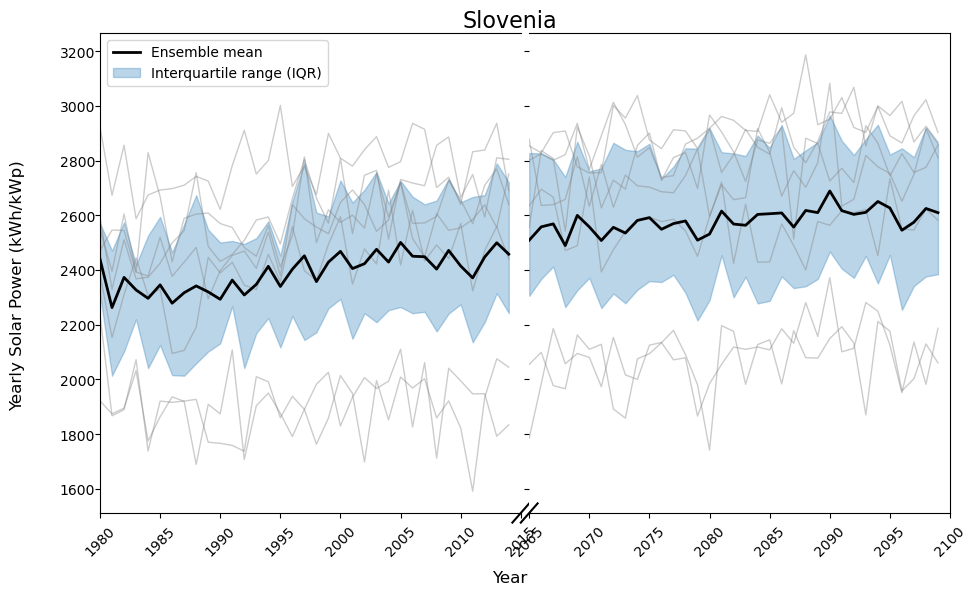

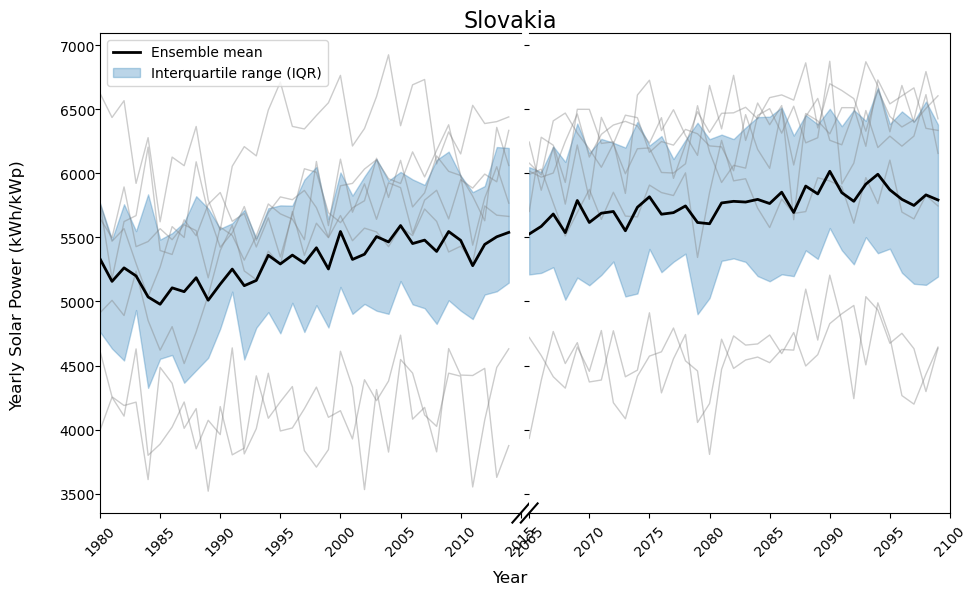

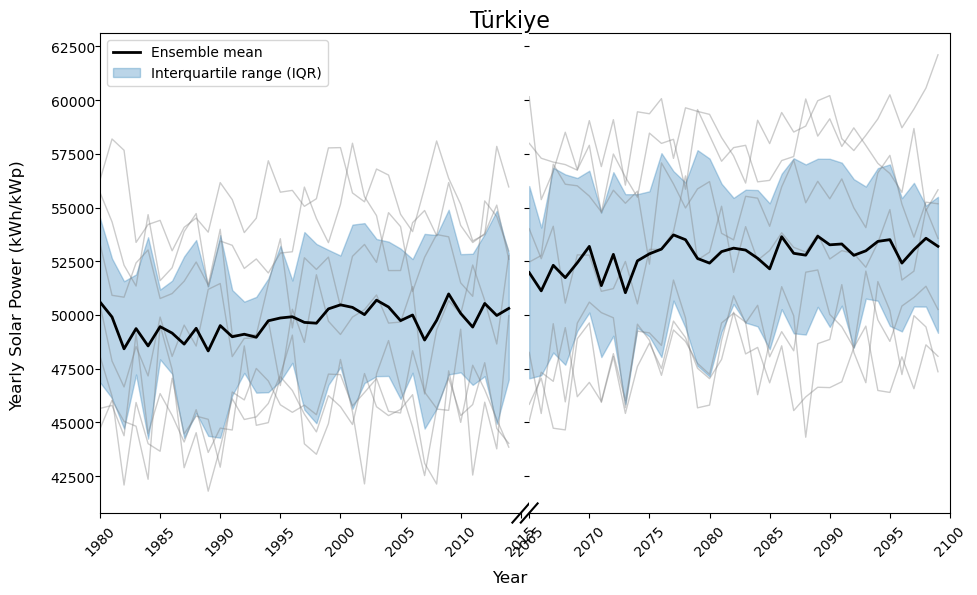

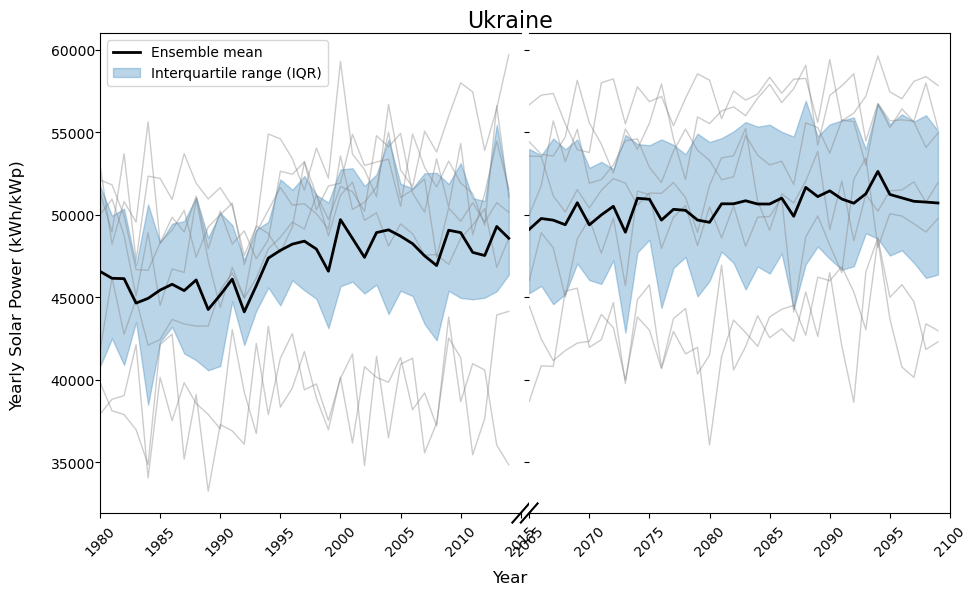

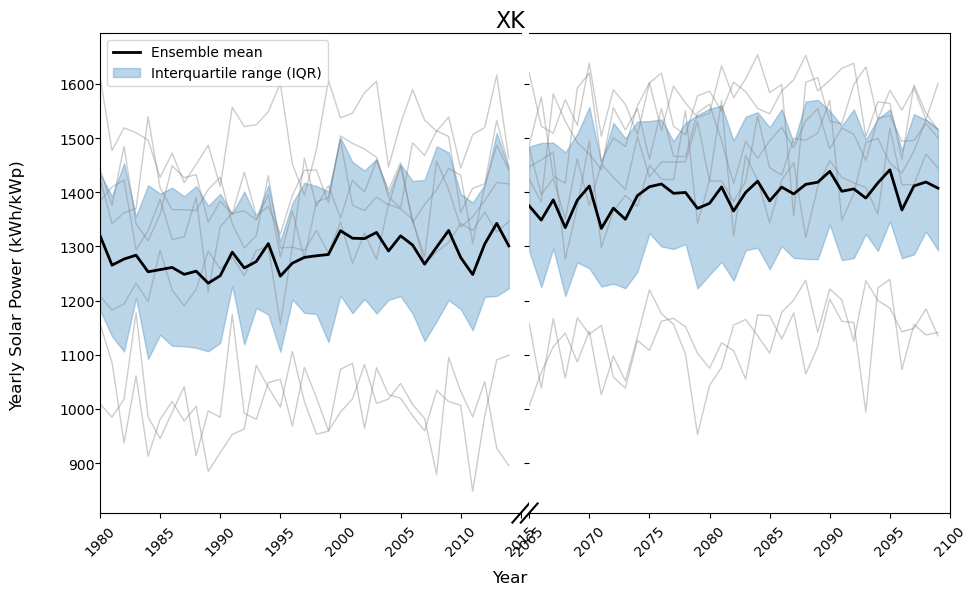

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import pycountry

# ─── 1) LOAD & FILTER YOUR CSV ────────────────────────────────────────────
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)

# keep only the annual data
df_ann = df[df['season'] == 'Annual'].copy()

# ─── 2) BUILD ISO2 → FULL NAME MAP ───────────────────────────────────────
iso2_to_name = {c.alpha_2: c.name for c in pycountry.countries}

# get sorted unique list of countries
isos = sorted(df_ann['ISO_A2'].unique())

# ─── 3) LOOP & PLOT ───────────────────────────────────────────────────────
for country_code in isos:
    country_name = iso2_to_name.get(country_code, country_code)
    df_ct = df_ann[df_ann['ISO_A2'] == country_code]

    fig, (ax1, ax2) = plt.subplots(
        1, 2, sharey=True, figsize=(10, 6),
        gridspec_kw={'width_ratios': [1, 1]}
    )

    # left side: historical
    ax1.set_xlim(df_ct['year'].min(), 2015)
    ax1.spines['right'].set_visible(False)
    # right side: future
    ax2.set_xlim(2065, df_ct['year'].max())
    ax2.spines['left'].set_visible(False)

    # diagonal breaks
    d = 0.02
    ax1.plot((1-d, 1+d), (-d, d), transform=ax1.transAxes,
             color='k', clip_on=False)
    ax2.plot((-d, d), (-d, d), transform=ax2.transAxes,
             color='k', clip_on=False)

    # plot for each period
    for (period, ax) in [('historical', ax1), ('ssp585', ax2)]:
        sub = df_ct[df_ct['period'] == period]
        if sub.empty:
            continue

        pivot = sub.pivot(index='year', columns='model', values='power').sort_index()

        # thin gray lines = individual models
        for m in pivot.columns:
            ax.plot(pivot.index, pivot[m], color='gray', alpha=0.4, lw=1)

        # thick black = ensemble mean
        emean = pivot.mean(axis=1)
        ax.plot(
            emean.index, emean,
            color='k', lw=2,
            label='Ensemble mean' if period == 'historical' else None
        )

        # shaded IQR
        q1 = pivot.quantile(0.25, axis=1)
        q3 = pivot.quantile(0.75, axis=1)
        ax.fill_between(
            pivot.index, q1, q3,
            color='C0', alpha=0.3,
            label='Interquartile range (IQR)' if period == 'historical' else None
        )

    # clean up x‐ticks
    xt1 = ax1.get_xticks()
    ax1.set_xticks(xt1[xt1 <= 2015])
    xt2 = ax2.get_xticks()
    ax2.set_xticks(xt2[xt2 >= 2065])
    for ax in (ax1, ax2):
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='y', pad=0)

    ax1.legend(loc='upper left')

    # titles & labels
    fig.suptitle(country_name, fontsize=16, y=0.96, x=0.55)
    fig.supxlabel('Year', y=0.0, x=0.55)
    fig.supylabel('Yearly Solar Power (kWh/kWp)', x=0.05)

    fig.subplots_adjust(left=0.14, right=0.99,
                        top=0.92, bottom=0.12, wspace=0.02)
    plt.show()



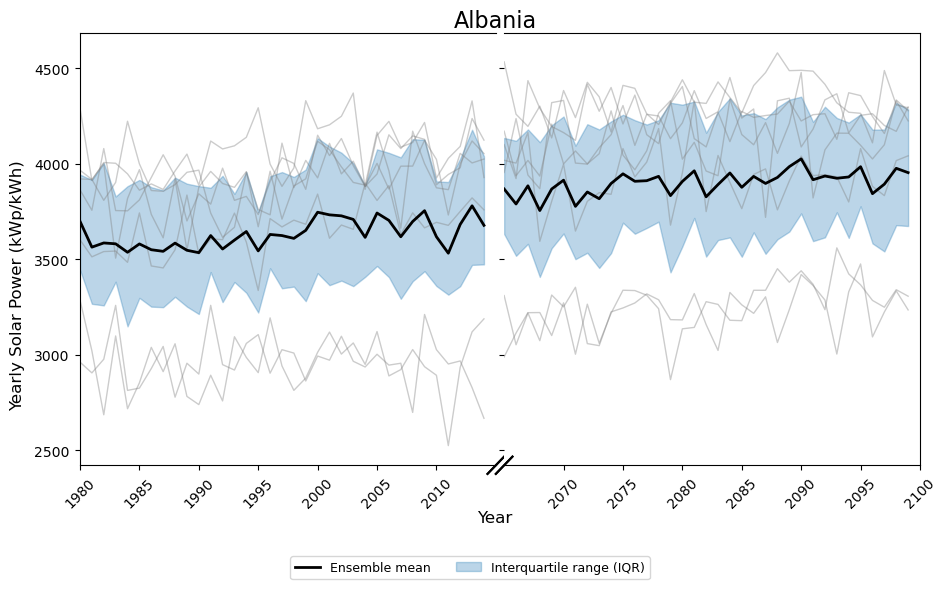

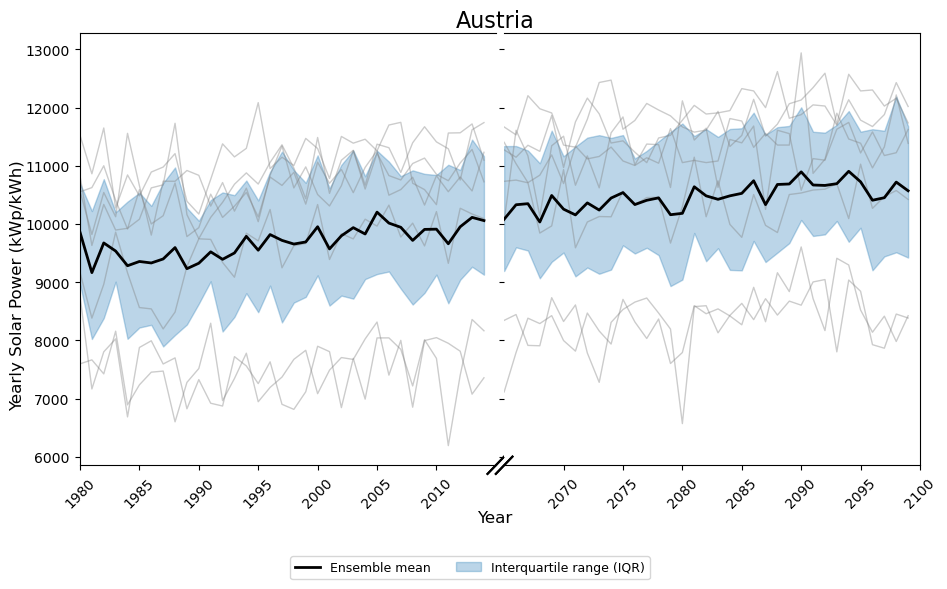

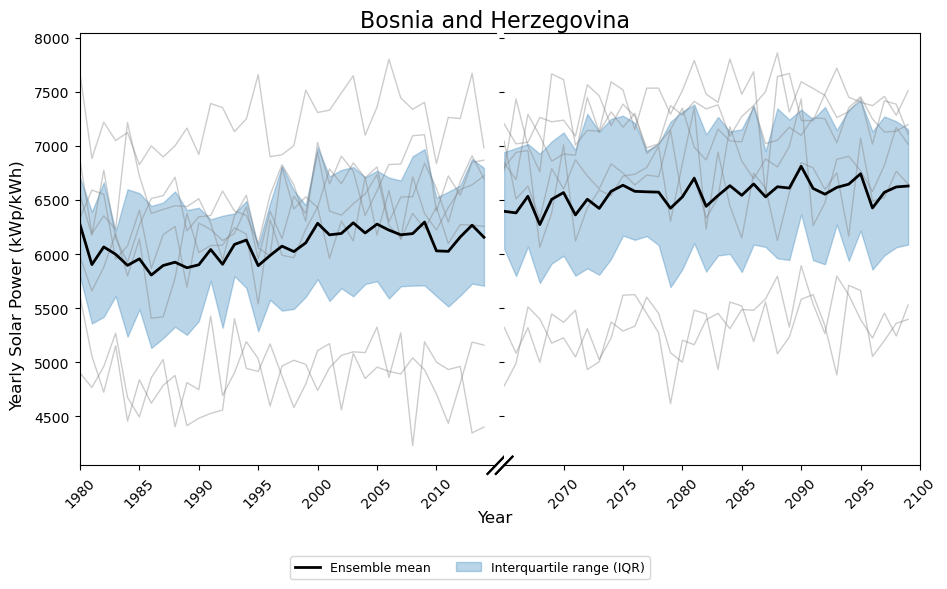

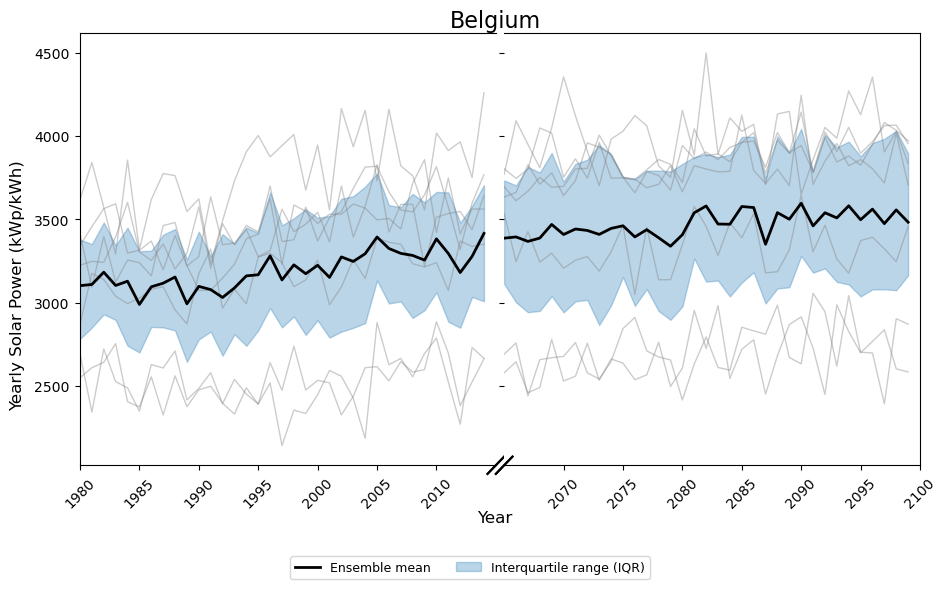

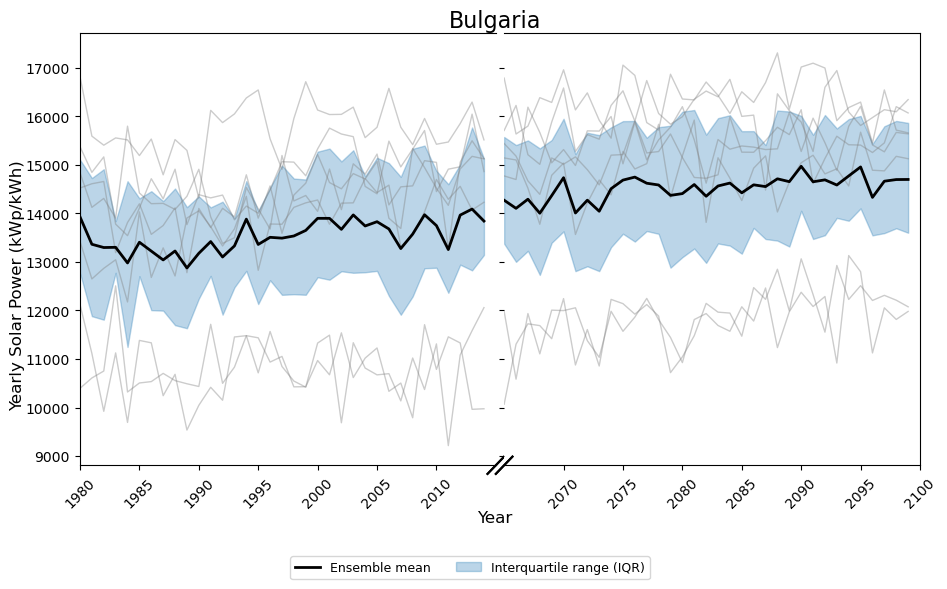

...

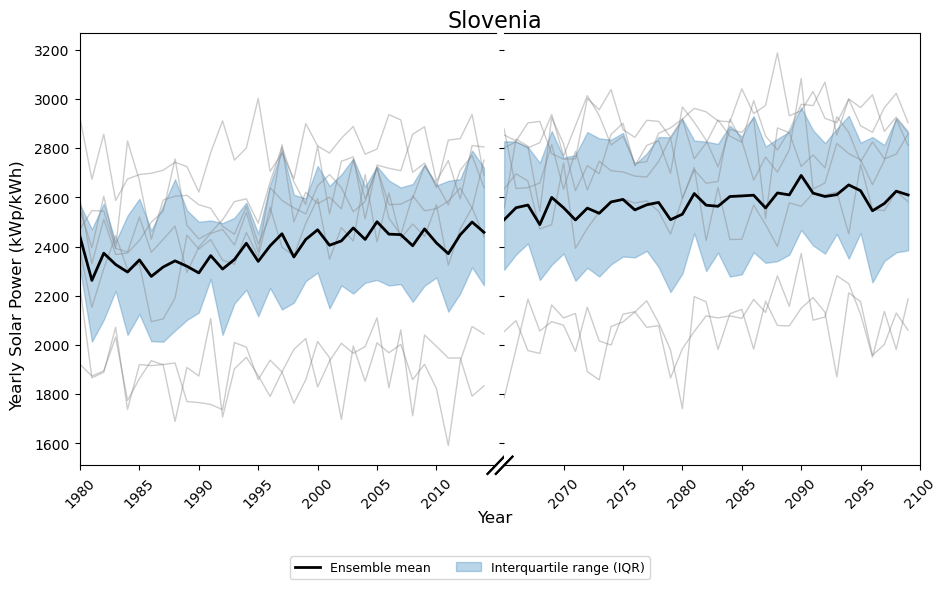

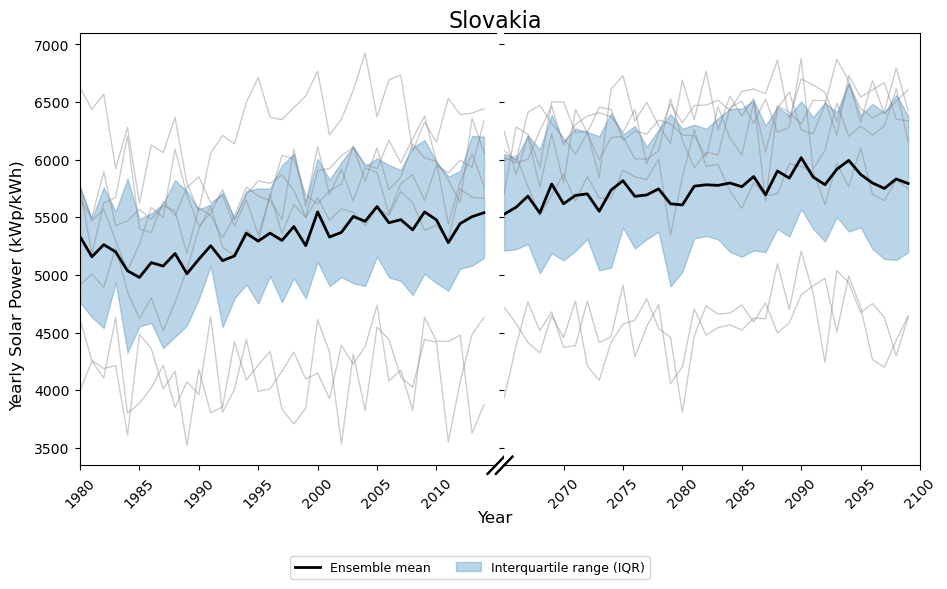

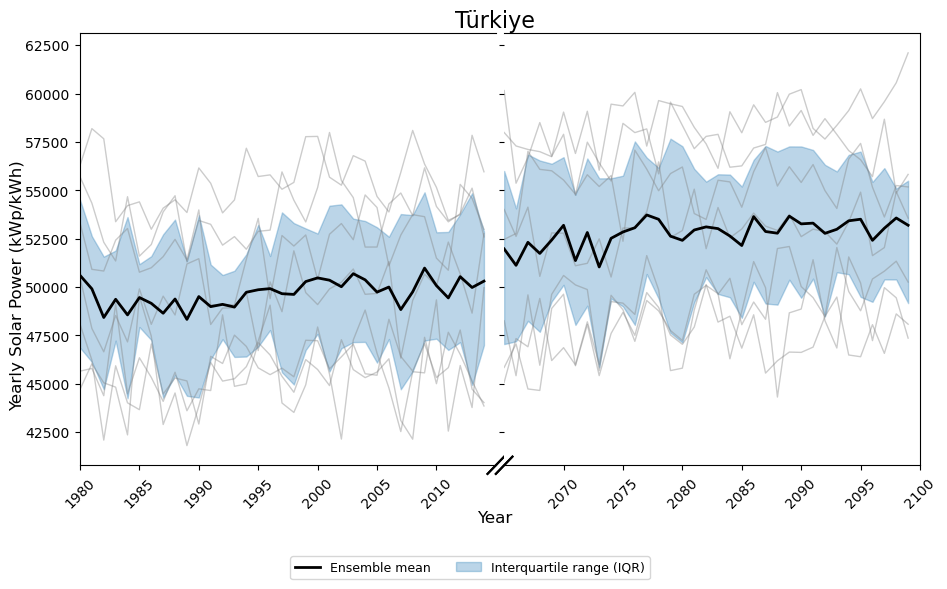

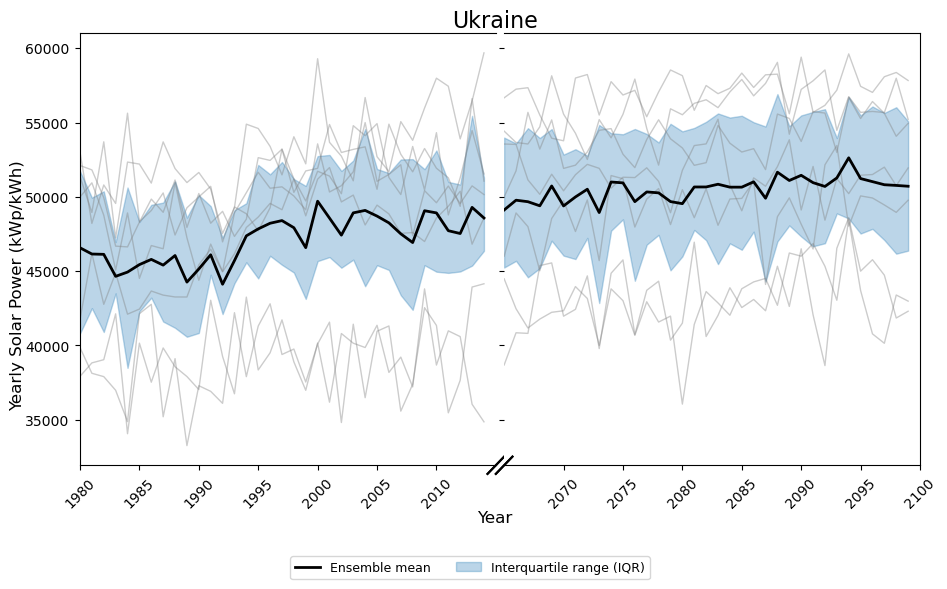

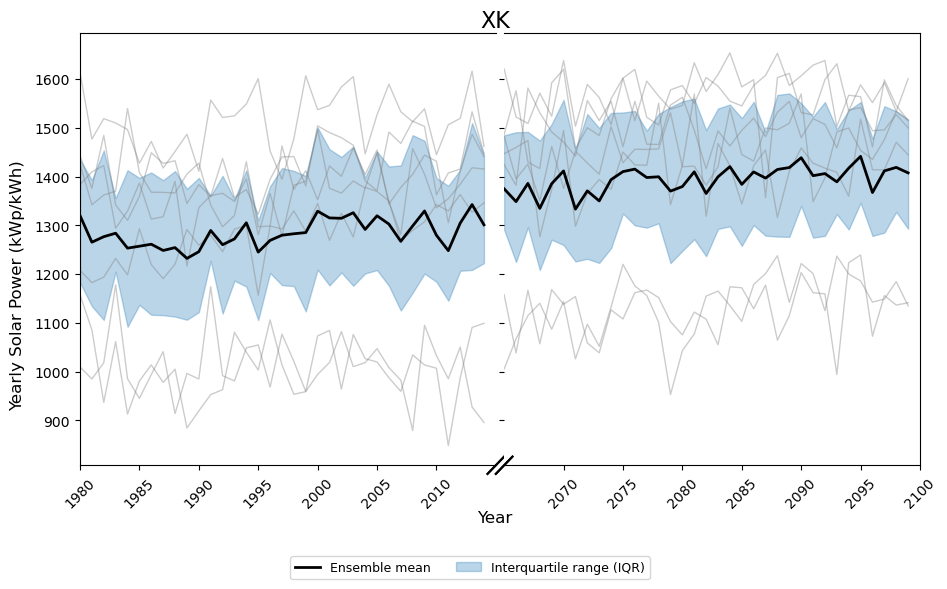

In [3]:
import matplotlib.pyplot as plt
import pycountry
import matplotlib.cm as cm

# ─── 1) LOAD & FILTER YOUR CSV ────────────────────────────────────────────
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)

# keep only the annual data
df_ann = df[df['season'] == 'Annual'].copy()

# ─── 2) BUILD ISO2 → FULL NAME MAP ───────────────────────────────────────
iso2_to_name = {c.alpha_2: c.name for c in pycountry.countries}

# get sorted unique list of countries
isos = sorted(df_ann['ISO_A2'].unique())

# ─── 3) LOOP & PLOT ───────────────────────────────────────────────────────
for country_code in isos:
    country_name = iso2_to_name.get(country_code, country_code)
    df_ct = df_ann[df_ann['ISO_A2'] == country_code]

    fig, (ax1, ax2) = plt.subplots(
        1, 2, sharey=True, figsize=(10, 6),
        gridspec_kw={'width_ratios': [1, 1]}
    )

    # left side: historical
    ax1.set_xlim(df_ct['year'].min(), 2015)
    ax1.spines['right'].set_visible(False)
    # right side: future
    ax2.set_xlim(2065, df_ct['year'].max())
    ax2.spines['left'].set_visible(False)

    # diagonal breaks
    d = 0.02
    ax1.plot((1-d, 1+d), (-d, d), transform=ax1.transAxes,
             color='k', clip_on=False)
    ax2.plot((-d, d), (-d, d), transform=ax2.transAxes,
             color='k', clip_on=False)

    # plot for each period
    for (period, ax) in [('historical', ax1), ('ssp585', ax2)]:
        sub = df_ct[df_ct['period'] == period]
        if sub.empty:
            continue

        pivot = sub.pivot(index='year', columns='model', values='power').sort_index()

        # thin gray lines = individual models
        for m in pivot.columns:
            ax.plot(pivot.index, pivot[m], color='gray', alpha=0.4, lw=1)

        # thick black = ensemble mean
        emean = pivot.mean(axis=1)
        ax.plot(
            emean.index, emean,
            color='k', lw=2,
            label='Ensemble mean' if period == 'historical' else None
        )

        # shaded IQR
        q1 = pivot.quantile(0.25, axis=1)
        q3 = pivot.quantile(0.75, axis=1)
        ax.fill_between(
            pivot.index, q1, q3,
            color='C0', alpha=0.3,
            label='Interquartile range (IQR)' if period == 'historical' else None
        )
        # Break slashes
    d = 0.02
    ax1.plot((1-d, 1+d), (-d, d), transform=ax1.transAxes,
             color='k', clip_on=False)
    ax2.plot((-d, d), (-d, d), transform=ax2.transAxes,
             color='k', clip_on=False)
    
    # Tidy up ticks
    xt1 = ax1.get_xticks()[:-1]
    xt2 = ax2.get_xticks()[1:]
    ax1.set_xticks(xt1)
    ax2.set_xticks(xt2)
    for ax in (ax1, ax2):
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='y', pad=4)

    # Single legend below the plot
    handles, labels = ax1.get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', fontsize=9, frameon=True, ncol=5, bbox_to_anchor=(0.5, 0))

    # Titles and labels
    fig.suptitle(country_name, fontsize=16, y=0.96, x=0.525)
    fig.supxlabel('Year', y=0.1, x=0.525)
    fig.supylabel('Yearly Solar Power (kWp/kWh)', x=0.04)

    fig.subplots_adjust(left=0.11, right=0.95,  # Adjust right to use more space for the plot
                        top=0.92, bottom=0.2, wspace=0.02)  # Increased bottom margin for legend

    plt.show()

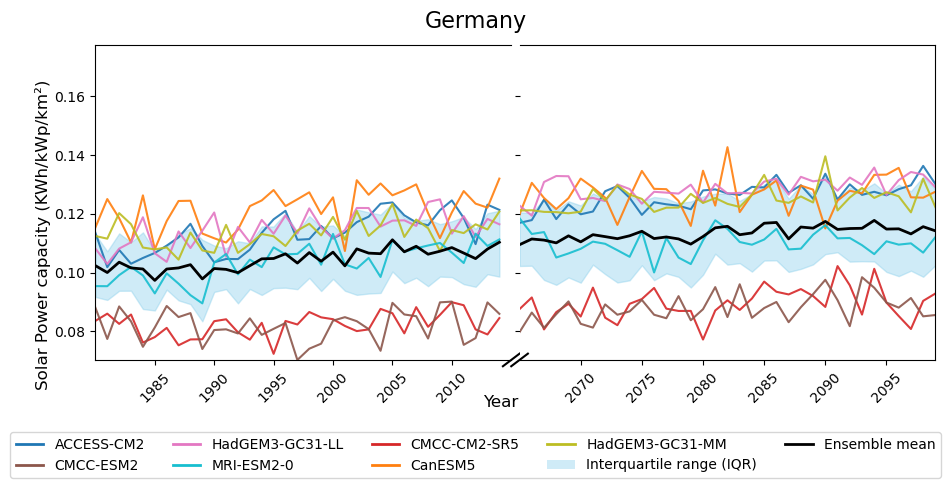

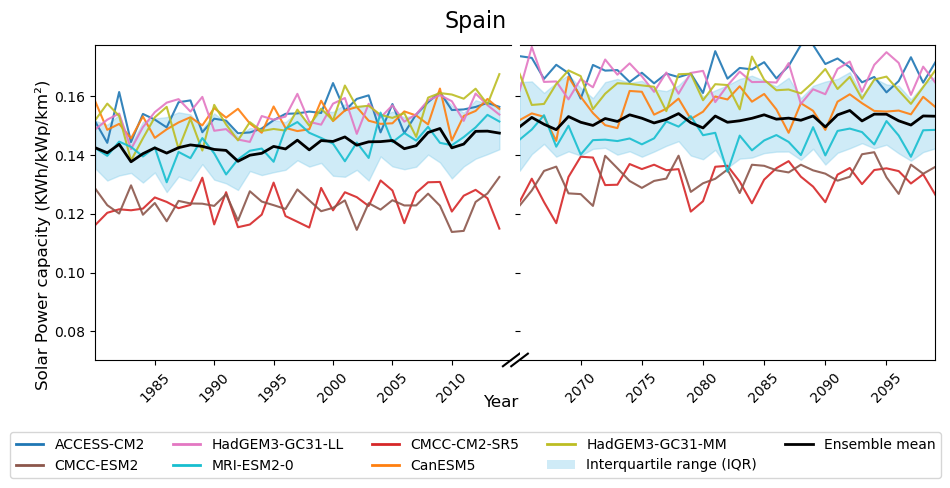

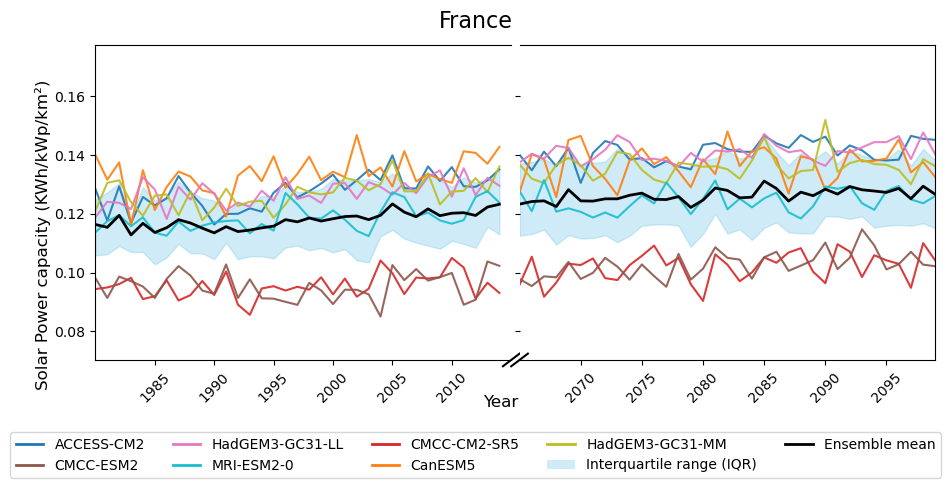

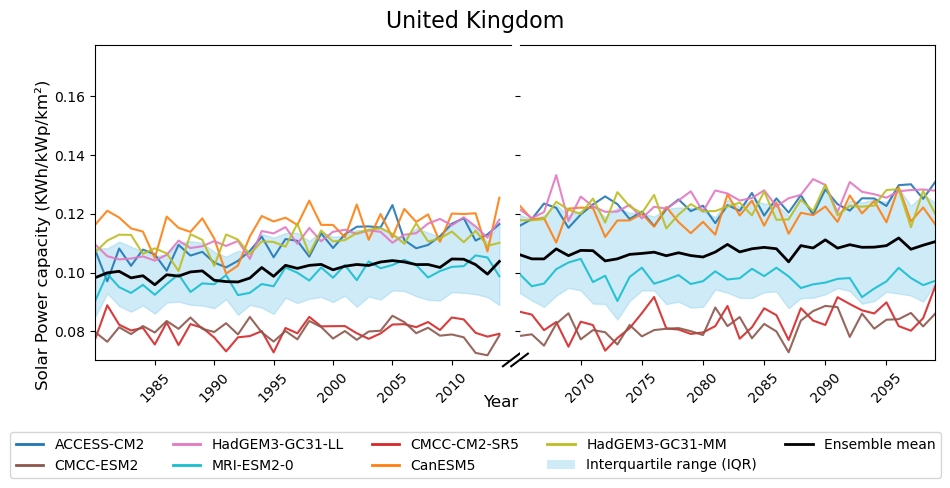

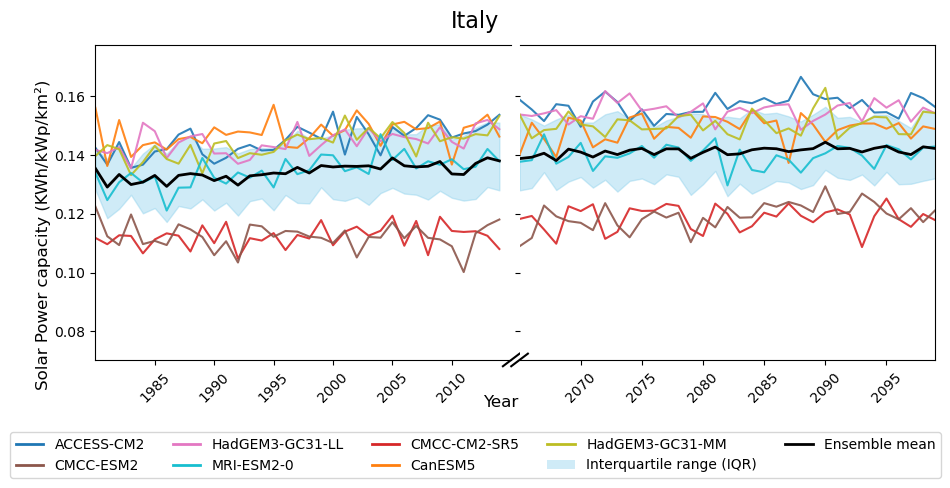

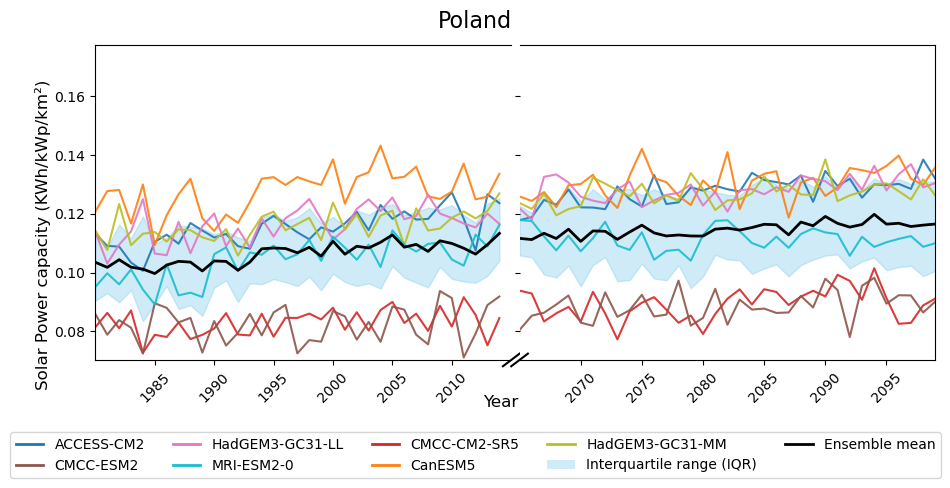

In [32]:
%matplotlib inline
import pandas as pd
import geopandas as gpd
import pycountry
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from shapely.geometry import box

# ─── 0) Six ISO3 → invert to ISO2 ────────────────────────────────────────
selected_iso3 = ['ESP','FRA','DEU','POL','GBR','ITA']
iso2_to_iso3 = {c.alpha_2:c.alpha_3 for c in pycountry.countries}
iso2_to_iso3['XK']='KOS'
iso3_to_iso2 = {v:k for k,v in iso2_to_iso3.items() if v in selected_iso3}
selected_iso2 = list(iso3_to_iso2.values())

# ─── 1) Load annual CSV & filter ─────────────────────────────────────────
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)
df = df[df['season']=='Annual'].copy()
df6 = df[df['ISO_A2'].isin(selected_iso2)].copy()

# ─── 2) Read Natural Earth, fix FR/NO, compute area ──────────────────────
ne50 = "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(ne50).to_crs("EPSG:4326")
world.loc[world['NAME_LONG']=='France','ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway','ISO_A2'] = 'NO'

# mainland Europe bbox
europe_bbox = box(-10.0,34.0,35.0,72.0)
bbox_gdf = gpd.GeoDataFrame([1],geometry=[europe_bbox],crs="EPSG:4326")

we = world[world['ISO_A2'].isin(selected_iso2)][['ISO_A2','geometry']].copy()
we_pa = we.to_crs("EPSG:3035")
bbox_pa = bbox_gdf.to_crs("EPSG:3035").geometry.iloc[0]

# clip France to mainland
mask_fr = we_pa['ISO_A2']=='FR'
we_pa.loc[mask_fr,'geometry'] = we_pa.loc[mask_fr,'geometry'].intersection(bbox_pa)

we_pa['area_km2'] = we_pa.geometry.area/1e6
area_lookup = we_pa.set_index('ISO_A2')['area_km2'].to_dict()

# ─── 3) Merge area & normalize ───────────────────────────────────────────
df6['area_km2'] = df6['ISO_A2'].map(area_lookup)
df6 = df6.dropna(subset=['area_km2']).copy()
df6['normalized_power'] = df6['power']/df6['area_km2']


# exact colors from your legend graphic
model_colors = {
    "ACCESS-CM2":     "#1f77b4",  # blue
    "CMCC-ESM2":      "#8c564b",  # brown
    "HadGEM3-GC31-LL":"#e377c2",  # pink
    "MRI-ESM2-0":     "#17becf",  # teal
    "CMCC-CM2-SR5":   "#d62728",  # red
    "CanESM5":        "#ff7f0e",  # orange
    "HadGEM3-GC31-MM":"#bcbd22",  # olive
}

# your usual name map
iso2_to_name = {c.alpha_2: c.name for c in pycountry.countries}

# 4.1) Compute global y‐limits across all six countries
ymin_all = df6['normalized_power'].min()
ymax_all = df6['normalized_power'].max()


for iso2 in selected_iso2:
    sub   = df6[df6['ISO_A2']==iso2]
    cname = iso2_to_name.get(iso2, iso2)

    # create the two‐panel figure
    fig, (ax1, ax2) = plt.subplots(
        1, 2, sharey=True, figsize=(10, 5),
        gridspec_kw={'width_ratios':[1,1]}
    )

    # fixed y‐limits for both panels
    for ax in (ax1, ax2):
        ax.set_ylim(ymin_all, ymax_all)

    # x‐limits & spine hiding
    ax1.set_xlim(sub['year'].min(), 2015)
    ax2.set_xlim(2065,            sub['year'].max())
    ax1.spines['right'].set_visible(False)
    ax2.spines['left'].set_visible(False)

    # diagonal breaks
    d=0.02
    ax1.plot((1-d,1+d),(-d,d),transform=ax1.transAxes,color='k',clip_on=False)
    ax2.plot((-d,d),(-d,d),transform=ax2.transAxes,color='k',clip_on=False)

    # plot each period
    for period,ax in [('historical',ax1),('ssp585',ax2)]:
        tmp = sub[sub['period']==period]
        if tmp.empty: continue
        pivot = tmp.pivot(index='year',columns='model',values='normalized_power').sort_index()

        # model lines
        for m in pivot.columns:
            ax.plot(pivot.index,pivot[m],
                    color=model_colors[m], lw=1.5, alpha=0.9,
                    label=m if period=='historical' else None)

        # ensemble mean
        em = pivot.mean(axis=1)
        ax.plot(em.index,em,color='k',lw=2,
                label='Ensemble mean' if period=='historical' else None)

        # IQR
        q1 = pivot.quantile(0.25,axis=1)
        q3 = pivot.quantile(0.75,axis=1)
        ax.fill_between(pivot.index,q1,q3,
                        color="skyblue", alpha=0.4,
                        label='Interquartile range (IQR)' if period=='historical' else None)

        # tidy ticks (drop 2015/2065)
    xt1 = ax1.get_xticks()
    ax1.set_xticks(xt1[(xt1>sub['year'].min()) & (xt1<2015)])
    xt2 = ax2.get_xticks()
    ax2.set_xticks(xt2[(xt2>2065) & (xt2<sub['year'].max())])
    for ax in (ax1, ax2):
        ax.tick_params(axis='x', rotation=45, pad=4)
        ax.tick_params(axis='y', pad=4)

    # collect handles in the precise order:
    handles = []
    labels  = []
    # first all models in the order given
    for m in ["ACCESS-CM2","CMCC-ESM2","HadGEM3-GC31-LL",
              "MRI-ESM2-0","CMCC-CM2-SR5","CanESM5","HadGEM3-GC31-MM"]:
        handles.append(plt.Line2D([],[],color=model_colors[m],lw=2))
        labels .append(m)
    # then IQR and Ensemble
    handles.append(plt.Rectangle((0,0),1,1,facecolor="skyblue",edgecolor="none",alpha=0.4))
    labels .append("Interquartile range (IQR)")
    handles.append(plt.Line2D([],[],color='k',lw=2))
    labels .append("Ensemble mean")

    # draw the legend at the very bottom (y=0)
    fig.legend(
        handles, labels,
        loc='lower center',
        ncol=5,
        frameon=True,
        bbox_to_anchor=(0.5, 0.0)
    )
        # country title back in
    fig.suptitle(
        f"{iso2_to_name[iso2]}",
        fontsize=16, y=0.95
    )

    # increase bottom margin so the legend and xlabel don't overlap
    fig.subplots_adjust(
        left=0.12,
        right=0.96,
        top=0.88,
        bottom=0.25,   # <-- was 0.15, now more room
        wspace=0.02
    )

    # nudge the “Year” label up a little
    fig.supxlabel("Year", y=0.15, x=0.525)
    fig.supylabel("Solar Power capacity (KWh/kWp/km²)", x=0.06)

    plt.show()

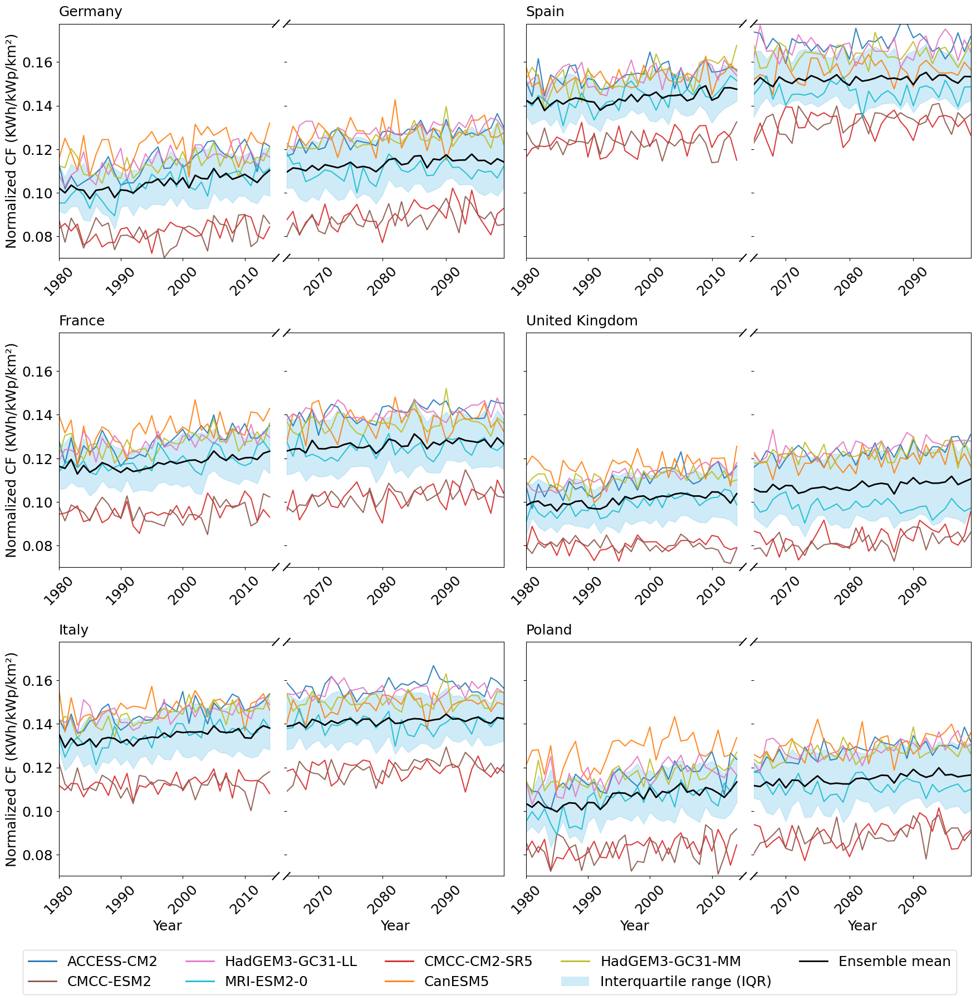

In [5]:
import pandas as pd
import geopandas as gpd
import pycountry
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from shapely.geometry import box
import numpy as np

# --- Data prep (same as before) ---
selected_iso3 = ['ESP','FRA','DEU','POL','GBR','ITA']
iso2_to_iso3 = {c.alpha_2:c.alpha_3 for c in pycountry.countries}
iso2_to_iso3['XK']='KOS'
iso3_to_iso2 = {v:k for k,v in iso2_to_iso3.items() if v in selected_iso3}
selected_iso2 = list(iso3_to_iso2.values())

csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)
df = df[df['season']=='Annual'].copy()
df6 = df[df['ISO_A2'].isin(selected_iso2)].copy()

ne50 = "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(ne50).to_crs("EPSG:4326")
world.loc[world['NAME_LONG']=='France','ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway','ISO_A2'] = 'NO'

europe_bbox = box(-10.0,34.0,35.0,72.0)
bbox_gdf = gpd.GeoDataFrame([1],geometry=[europe_bbox],crs="EPSG:4326")
we = world[world['ISO_A2'].isin(selected_iso2)][['ISO_A2','geometry']].copy()
we_pa = we.to_crs("EPSG:3035")
bbox_pa = bbox_gdf.to_crs("EPSG:3035").geometry.iloc[0]
mask_fr = we_pa['ISO_A2']=='FR'
we_pa.loc[mask_fr,'geometry'] = we_pa.loc[mask_fr,'geometry'].intersection(bbox_pa)
we_pa['area_km2'] = we_pa.geometry.area/1e6
area_lookup = we_pa.set_index('ISO_A2')['area_km2'].to_dict()
df6['area_km2'] = df6['ISO_A2'].map(area_lookup)
df6 = df6.dropna(subset=['area_km2']).copy()
df6['normalized_power'] = df6['power']/df6['area_km2']

model_colors = {
    "ACCESS-CM2":     "#1f77b4",
    "CMCC-ESM2":      "#8c564b",
    "HadGEM3-GC31-LL":"#e377c2",
    "MRI-ESM2-0":     "#17becf",
    "CMCC-CM2-SR5":   "#d62728",
    "CanESM5":        "#ff7f0e",
    "HadGEM3-GC31-MM":"#bcbd22",
}
iso2_to_name = {c.alpha_2: c.name for c in pycountry.countries}
ymin_all = df6['normalized_power'].min()
ymax_all = df6['normalized_power'].max()

# --- Plotting with broken x-axis for each country ---
fig = plt.figure(figsize=(18, 18))
gs = gridspec.GridSpec(3, 2, hspace=0.32, wspace=0.05)
axes = []

# ...existing code up to the plotting loop...

for idx, iso2 in enumerate(selected_iso2):
    row, col = divmod(idx, 2)
    # Create two axes for each country: left (historical), right (ssp585)
    gs_left = gridspec.GridSpecFromSubplotSpec(1, 2, subplot_spec=gs[idx], width_ratios=[1, 1], wspace=0.05)
    ax1 = plt.Subplot(fig, gs_left[0])
    ax2 = plt.Subplot(fig, gs_left[1], sharey=ax1)
    fig.add_subplot(ax1)
    fig.add_subplot(ax2)
    axes.append((ax1, ax2))

    sub = df6[df6['ISO_A2']==iso2]
    cname = iso2_to_name.get(iso2, iso2)

    # Set y-limits
    ax1.set_ylim(ymin_all, ymax_all)
    ax2.set_ylim(ymin_all, ymax_all)

    # Set x-limits
    ax1.set_xlim(sub['year'].min(), 2015)
    ax2.set_xlim(2065, sub['year'].max())

    # Hide spines for break
    ax1.spines['right'].set_visible(False)
    ax2.spines['left'].set_visible(False)

    # Diagonal break marks
    d = .015
    kwargs = dict(transform=ax1.transAxes, color='k', clip_on=False)
    ax1.plot((1-d,1+d),(-d,+d), **kwargs)
    ax1.plot((1-d,1+d),(1-d,1+d), **kwargs)
    kwargs2 = dict(transform=ax2.transAxes, color='k', clip_on=False)
    ax2.plot((-d,+d),(-d,+d), **kwargs2)
    ax2.plot((-d,+d),(1-d,1+d), **kwargs2)

    # Plot each period
    for period, ax in [('historical', ax1), ('ssp585', ax2)]:
        tmp = sub[sub['period']==period]
        if tmp.empty: continue
        pivot = tmp.pivot(index='year',columns='model',values='normalized_power').sort_index()
        # model lines
        for m in pivot.columns:
            ax.plot(pivot.index,pivot[m],
                    color=model_colors[m], lw=1.5, alpha=0.9)
        # ensemble mean
        em = pivot.mean(axis=1)
        ax.plot(em.index,em,color='k',lw=2)
        # IQR
        q1 = pivot.quantile(0.25,axis=1)
        q3 = pivot.quantile(0.75,axis=1)
        ax.fill_between(pivot.index,q1,q3,
                        color="skyblue", alpha=0.4)

    # Tidy ticks
    # …existing code…
    # Tidy ticks
    for a in (ax1, ax2):
        a.tick_params(axis='x', rotation=45, pad=4, labelsize=18)
        a.tick_params(axis='y', pad=4, labelsize=18)

    # only first-col left axes show y-tick labels; hide all others
    if col == 0:
        ax1.set_ylabel("Normalized CF (KWh/kWp/km²)", fontsize=18)
        ax1.tick_params(axis='y', labelleft=True, labelright=False)
    else:
        ax1.tick_params(axis='y', labelleft=False)

    # never show y-labels on the right-hand subplot
    ax2.tick_params(axis='y', labelleft=False)
# …existing code…

    # Only label bottom x-axis
    if row == 2:
        ax1.set_xlabel("Year", fontsize=18)
        ax2.set_xlabel("Year", fontsize=18)
    # Title
    ax1.set_title(cname, fontsize=18, pad=10, loc='left')


# --- Common legend ---
handles = []
labels  = []
for m in ["ACCESS-CM2","CMCC-ESM2","HadGEM3-GC31-LL",
          "MRI-ESM2-0","CMCC-CM2-SR5","CanESM5","HadGEM3-GC31-MM"]:
    handles.append(plt.Line2D([],[],color=model_colors[m],lw=2))
    labels .append(m)
handles.append(plt.Rectangle((0,0),1,1,facecolor="skyblue",edgecolor="none",alpha=0.4))
labels .append("Interquartile range (IQR)")
handles.append(plt.Line2D([],[],color='k',lw=2))
labels .append("Ensemble mean")

fig.legend(
    handles, labels,
    loc='lower center',
    ncol=5,
    frameon=True,
    bbox_to_anchor=(0.5, -0.025),
    fontsize=18
)

plt.subplots_adjust(left=0.07, right=0.98, top=0.95, bottom=0.10)
plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/yearly_histogram.pdf", bbox_inches='tight', dpi=300)
plt.show()


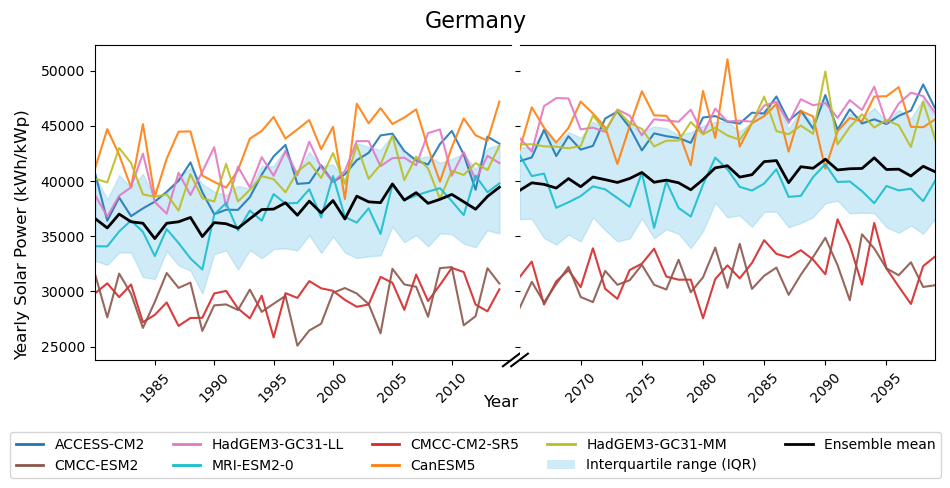

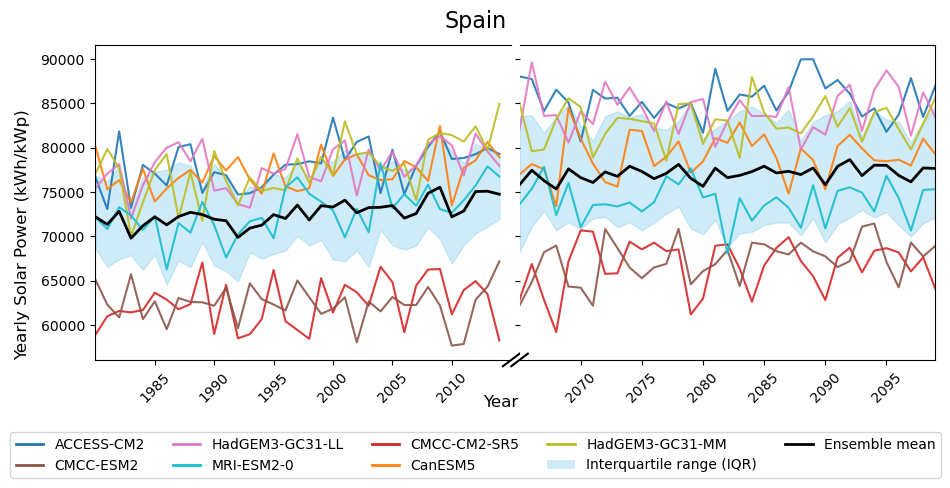

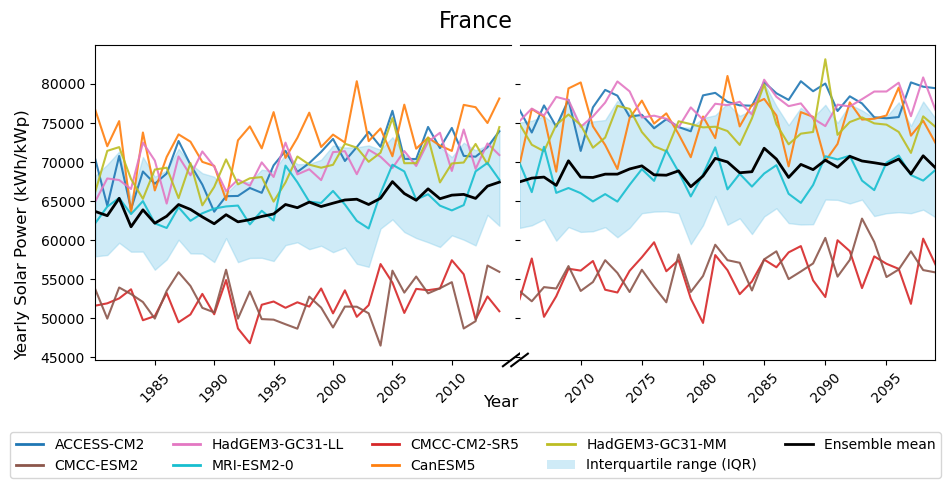

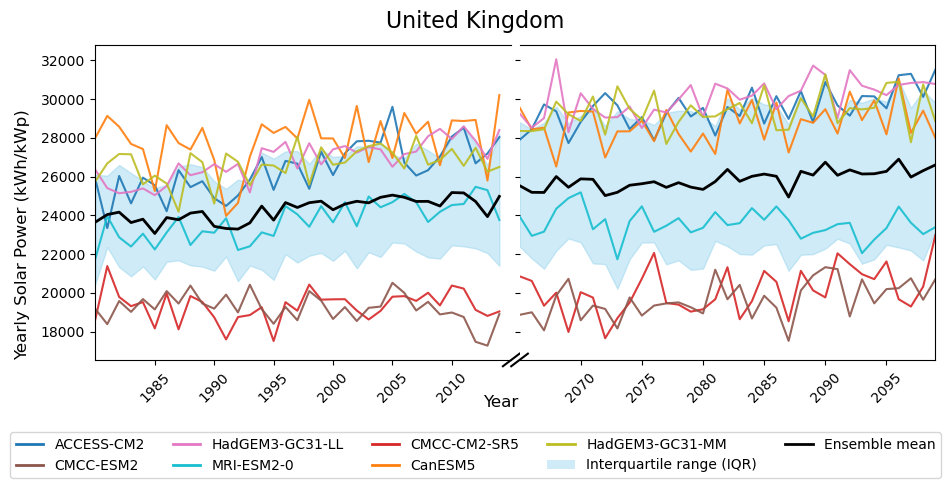

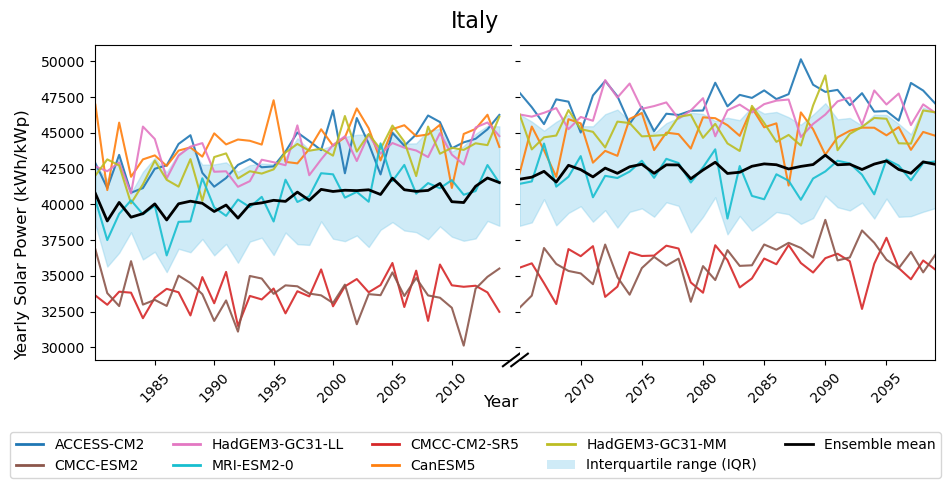

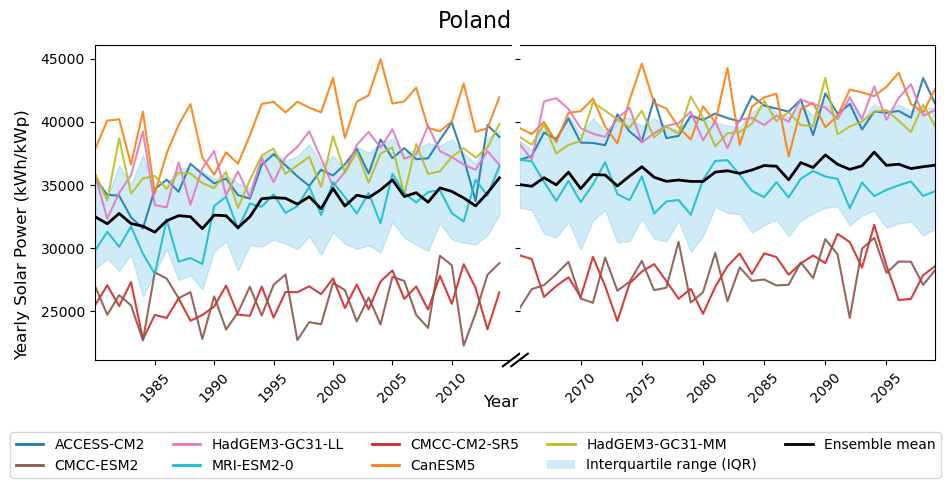

In [40]:
import pandas as pd
import geopandas as gpd
import pycountry
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from shapely.geometry import box

# ─── 0) Six ISO3 → invert to ISO2 ────────────────────────────────────────
selected_iso3 = ['ESP','FRA','DEU','POL','GBR','ITA']
iso2_to_iso3 = {c.alpha_2:c.alpha_3 for c in pycountry.countries}
iso2_to_iso3['XK']='KOS'
iso3_to_iso2 = {v:k for k,v in iso2_to_iso3.items() if v in selected_iso3}
selected_iso2 = list(iso3_to_iso2.values())

# ─── 1) Load annual CSV & filter ─────────────────────────────────────────
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)
df = df[df['season']=='Annual'].copy()
df6 = df[df['ISO_A2'].isin(selected_iso2)].copy()

# ─── 2) Read Natural Earth, fix FR/NO, compute area ──────────────────────
ne50 = "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(ne50).to_crs("EPSG:4326")
world.loc[world['NAME_LONG']=='France','ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway','ISO_A2'] = 'NO'

# mainland Europe bbox
europe_bbox = box(-10.0,34.0,35.0,72.0)
bbox_gdf = gpd.GeoDataFrame([1],geometry=[europe_bbox],crs="EPSG:4326")

we = world[world['ISO_A2'].isin(selected_iso2)][['ISO_A2','geometry']].copy()
we_pa = we.to_crs("EPSG:3035")
bbox_pa = bbox_gdf.to_crs("EPSG:3035").geometry.iloc[0]

# clip France to mainland
mask_fr = we_pa['ISO_A2']=='FR'
we_pa.loc[mask_fr,'geometry'] = we_pa.loc[mask_fr,'geometry'].intersection(bbox_pa)

we_pa['area_km2'] = we_pa.geometry.area/1e6
area_lookup = we_pa.set_index('ISO_A2')['area_km2'].to_dict()

# ─── 3) Merge area & normalize ───────────────────────────────────────────
df6['area_km2'] = df6['ISO_A2'].map(area_lookup)
df6 = df6.dropna(subset=['area_km2']).copy()
df6['normalized_power'] = df6['power']/df6['area_km2']


# exact colors from your legend graphic
model_colors = {
    "ACCESS-CM2":     "#1f77b4",  # blue
    "CMCC-ESM2":      "#8c564b",  # brown
    "HadGEM3-GC31-LL":"#e377c2",  # pink
    "MRI-ESM2-0":     "#17becf",  # teal
    "CMCC-CM2-SR5":   "#d62728",  # red
    "CanESM5":        "#ff7f0e",  # orange
    "HadGEM3-GC31-MM":"#bcbd22",  # olive
}

# your usual name map
iso2_to_name = {c.alpha_2: c.name for c in pycountry.countries}


for iso2 in selected_iso2:
    sub   = df6[df6['ISO_A2']==iso2]
    cname = iso2_to_name.get(iso2, iso2)

    # create the two‐panel figure
    fig, (ax1, ax2) = plt.subplots(
        1, 2, sharey=True, figsize=(10, 5),
        gridspec_kw={'width_ratios':[1,1]}
    )

    # fixed y‐limits for both panels
    #for ax in (ax1, ax2):
     #   ax.set_ylim(ymin_all, ymax_all)

    # x‐limits & spine hiding
    ax1.set_xlim(sub['year'].min(), 2015)
    ax2.set_xlim(2065,            sub['year'].max())
    ax1.spines['right'].set_visible(False)
    ax2.spines['left'].set_visible(False)

    # diagonal breaks
    d=0.02
    ax1.plot((1-d,1+d),(-d,d),transform=ax1.transAxes,color='k',clip_on=False)
    ax2.plot((-d,d),(-d,d),transform=ax2.transAxes,color='k',clip_on=False)

    # plot each period
    for period,ax in [('historical',ax1),('ssp585',ax2)]:
        tmp = sub[sub['period']==period]
        if tmp.empty: continue
        pivot = tmp.pivot(index='year',columns='model',values='power').sort_index()

        # model lines
        for m in pivot.columns:
            ax.plot(pivot.index,pivot[m],
                    color=model_colors[m], lw=1.5, alpha=0.9,
                    label=m if period=='historical' else None)

        # ensemble mean
        em = pivot.mean(axis=1)
        ax.plot(em.index,em,color='k',lw=2,
                label='Ensemble mean' if period=='historical' else None)

        # IQR
        q1 = pivot.quantile(0.25,axis=1)
        q3 = pivot.quantile(0.75,axis=1)
        ax.fill_between(pivot.index,q1,q3,
                        color="skyblue", alpha=0.4,
                        label='Interquartile range (IQR)' if period=='historical' else None)

        # tidy ticks (drop 2015/2065)
    xt1 = ax1.get_xticks()
    ax1.set_xticks(xt1[(xt1>sub['year'].min()) & (xt1<2015)])
    xt2 = ax2.get_xticks()
    ax2.set_xticks(xt2[(xt2>2065) & (xt2<sub['year'].max())])
    for ax in (ax1, ax2):
        ax.tick_params(axis='x', rotation=45, pad=4)
        ax.tick_params(axis='y', pad=4)

    # collect handles in the precise order:
    handles = []
    labels  = []
    # first all models in the order given
    for m in ["ACCESS-CM2","CMCC-ESM2","HadGEM3-GC31-LL",
              "MRI-ESM2-0","CMCC-CM2-SR5","CanESM5","HadGEM3-GC31-MM"]:
        handles.append(plt.Line2D([],[],color=model_colors[m],lw=2))
        labels .append(m)
    # then IQR and Ensemble
    handles.append(plt.Rectangle((0,0),1,1,facecolor="skyblue",edgecolor="none",alpha=0.4))
    labels .append("Interquartile range (IQR)")
    handles.append(plt.Line2D([],[],color='k',lw=2))
    labels .append("Ensemble mean")

    # draw the legend at the very bottom (y=0)
    fig.legend(
        handles, labels,
        loc='lower center',
        ncol=5,
        frameon=True,
        bbox_to_anchor=(0.5, 0.0)
    )
        # country title back in
    fig.suptitle(
        f"{iso2_to_name[iso2]}",
        fontsize=16, y=0.95
    )

    # increase bottom margin so the legend and xlabel don't overlap
    fig.subplots_adjust(
        left=0.12,
        right=0.96,
        top=0.88,
        bottom=0.25,   # <-- was 0.15, now more room
        wspace=0.02
    )

    # nudge the “Year” label up a little
    fig.supxlabel("Year", y=0.15, x=0.525)
    fig.supylabel("Yearly Solar Power (kWh/kWp)", x=0.04)

    plt.show()

In [15]:
import os
import xarray as xr
import geopandas as gpd
import pandas as pd
import numpy as np
from shapely.geometry import box
from scipy.stats import shapiro, ttest_ind

# -------------------------------------------------------------------------
# 1) CONFIGURATION
# -------------------------------------------------------------------------
DIRI = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/"
models = [
    "ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2",
    "HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"
]
EU27 = [
    'AT','BE','BG','HR','CZ','DK','EE','FI','FR','DE','GR',
    'HU','IE','IT','LV','LT','LU','MT','NL','PL','PT','RO',
    'SK','SI','ES','SE','CY'
]
extras = ['GB','NO','BA','ME','RS','AL','MK','CH','TR','UA','BY','MD','RU','XK']
region_codes = EU27 + extras
years_BOC = range(1980, 2015)
years_EOC = range(2065, 2100)
data_var  = 'specific generation'

# -------------------------------------------------------------------------
# 2) BUILD 1°×1° GRID-CELL POLYGONS
# -------------------------------------------------------------------------
sample_fp = os.path.join(
    DIRI,
    f"{models[0]}_1x1grid/historical/aggregated_solar_power_{years_BOC[0]}.nc"
)
ds_sample = xr.open_dataset(sample_fp, engine='netcdf4')
lats = ds_sample['lat'].values
lons = ds_sample['lon'].values
ds_sample.close()

dlat = float(np.diff(lats).mean())
dlon = float(np.diff(lons).mean())

cells = []
for lat in lats:
    for lon in lons:
        cells.append({
            'lon': float(lon),
            'lat': float(lat),
            'geometry': box(
                lon - dlon/2, lat - dlat/2,
                lon + dlon/2, lat + dlat/2
            )
        })
gdf_cells = gpd.GeoDataFrame(cells, crs="EPSG:4326")

# -------------------------------------------------------------------------
# 3) LOAD & FILTER COUNTRIES (EU27 + EXTRAS)
# -------------------------------------------------------------------------
ne50 = (
    "https://naturalearth.s3.amazonaws.com/50m_cultural/"
    "ne_50m_admin_0_countries.zip"
)
world = gpd.read_file(ne50).to_crs("EPSG:4326")
world.loc[world['NAME_LONG']=='France', 'ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway', 'ISO_A2'] = 'NO'
# Kosovo fix
if 'Kosovo' in world['NAME_LONG'].values:
    world.loc[world['NAME_LONG']=='Kosovo','ISO_A2']='XK'
eu_plus = world[world['ISO_A2'].isin(region_codes)][['ISO_A2','geometry']].copy()

# -------------------------------------------------------------------------
# 4) INTERSECT & COMPUTE GRID-CELL WEIGHTS (Corrected)
# -------------------------------------------------------------------------
# 4a) Overlay in EPSG:4326 so boxes and country shapes share coords
cells4326     = gdf_cells
countries4326 = eu_plus.to_crs("EPSG:4326")

# optional tiny buffer to fill any micro-slivers
countries4326['geometry'] = (
    countries4326.geometry.buffer(0).buffer(1e-6)
)

inter4326 = gpd.overlay(cells4326, countries4326, how='intersection')

# 4b) Reproject only the intersections to an equal-area CRS
proj_crs = "EPSG:3035"
inter_pa = inter4326.to_crs(proj_crs)
inter_pa['overlap_area'] = inter_pa.geometry.area

# 4c) Also get full cell area by projecting gdf_cells
cells_pa = cells4326.to_crs(proj_crs)
cells_pa['cell_area'] = cells_pa.geometry.area

# 4d) Merge and compute weight
inter_pa = inter_pa.merge(
    cells_pa[['lon','lat','cell_area']],
    on=['lon','lat'], how='left'
)
inter_pa['weight'] = inter_pa['overlap_area'] / inter_pa['cell_area']

# 4e) Sanity check
ws = inter_pa.groupby(['lon','lat'])['weight'].sum().round(6)
print("Weight sums per cell:", ws.describe())
# Expect min≈max≈1.0

# Keep only the columns we need
inter = inter_pa[['lon','lat','ISO_A2','weight']].reset_index(drop=True)




/tmp/ipykernel_21918/3077799231.py:80: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  countries4326.geometry.buffer(0).buffer(1e-6)


Weight sums per cell: count    1177.000000
mean        0.761828
std         0.355531
min         0.000020
25%         0.510454
50%         0.999841
75%         1.000000
max         1.000820
Name: weight, dtype: float64


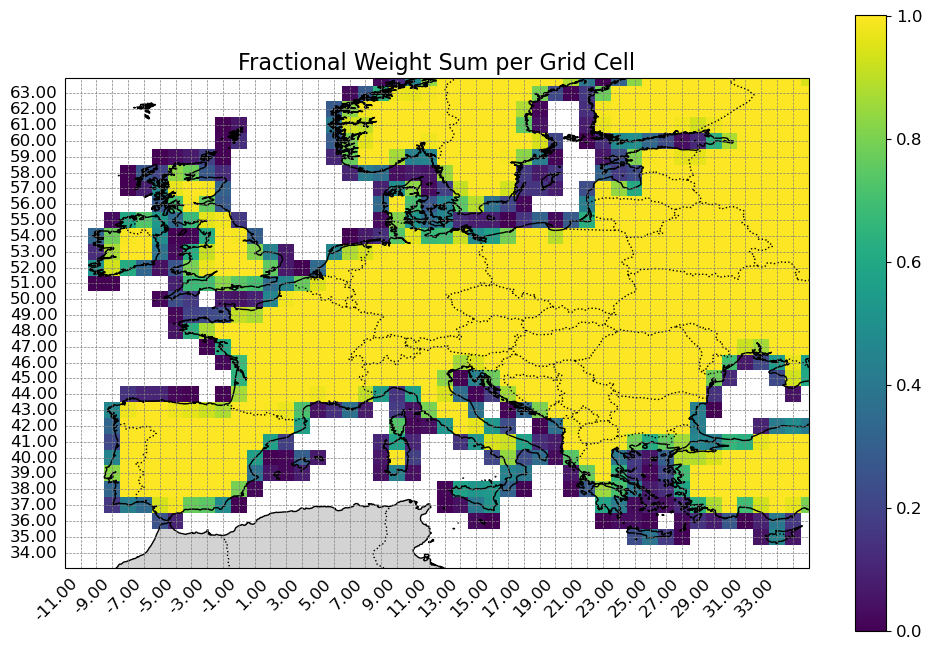

In [16]:
import xarray as xr
import matplotlib.pyplot as plt
ws = (
    inter
    .groupby(['lon','lat'])['weight']
    .sum()
    .reset_index(name='w_sum')
)
# pivot w_sum back into a 2D grid
lons = np.array(sorted(gdf_cells['lon'].unique()))
lats = np.array(sorted(gdf_cells['lat'].unique()))

wmat = np.full((len(lats), len(lons)), np.nan)
for lon, lat, ws in ws.itertuples(index=False):
    i = np.searchsorted(lons, lon)
    j = np.searchsorted(lats, lat)
    wmat[j, i] = ws

da = xr.DataArray(
    wmat,
    coords={'x': lons, 'y': lats},
    dims=('y','x'),
    name='weight_sum'
)

from plots import map_plots
map_plots(da, title="Fractional Weight Sum per Grid Cell", cmap="viridis", vmin=0, label="")



In [17]:
# ── 5) HELPER: SUM-WEIGHTED AGGREGATION ────────────────────────────────────
def country_aggregated(da2d, inter_gdf):
    """
    da2d: xarray.DataArray with dims ('lat','lon')
    inter_gdf: GeoDataFrame with columns ['lon','lat','ISO_A2','weight']
    """
    df = da2d.to_dataframe(name="power").reset_index()
    df = df.merge(inter_gdf, on=["lon","lat"], how="inner")
    df["contrib"] = df["power"] * df["weight"]
    return df.groupby("ISO_A2")["contrib"].sum()

# ── 6) LOOP MODELS & YEARS → RECORD SEASONAL & ANNUAL TOTALS ───────────────
seasons = ["Winter","Spring","Summer","Autumn"]
records = []

for model in models:
    for period, yr_range in zip(periods, years):
        for year in yr_range:
            # Seasonal data
            fp_s = os.path.join(
                base_dir,
                f"{model}_1x1grid/{period}/aggregated_solar_power_seasons_{year}.nc"
            )
            if os.path.exists(fp_s):
                ds_s = xr.open_dataset(fp_s)
                for season in seasons:
                    da = ds_s[season]  # dims=(lat,lon)
                    ct = country_aggregated(da, inter)
                    for iso2, val in ct.items():
                        records.append({
                            "model":  model,
                            "period": period,
                            "year":   year,
                            "ISO_A2": iso2,
                            "season": season,
                            "power":  float(val)
                        })
                ds_s.close()

            # Annual data
            fp_a = os.path.join(
                base_dir,
                f"{model}_1x1grid/{period}/solar_power_{year}.nc"
            )
            if os.path.exists(fp_a):
                ds_a = xr.open_dataset(fp_a)
                var = list(ds_a.data_vars)[0]
                da_ann = ds_a[var]  # dims=(lat,lon)
                ct_ann = country_aggregated(da_ann, inter)
                for iso2, val in ct_ann.items():
                    records.append({
                        "model":  model,
                        "period": period,
                        "year":   year,
                        "ISO_A2": iso2,
                        "season": "Annual",
                        "power":  float(val)
                    })
                ds_a.close()

# ── 7) SAVE TO CSV ───────────────────────────────────────────────────────────
df = pd.DataFrame.from_records(records)
csv_path = "country_seasonal_and_annual_power_fractional.csv"
df.to_csv(csv_path, index=False)
print(f"Wrote {len(df)} rows to {csv_path}")

Wrote 100450 rows to country_seasonal_and_annual_power_fractional.csv


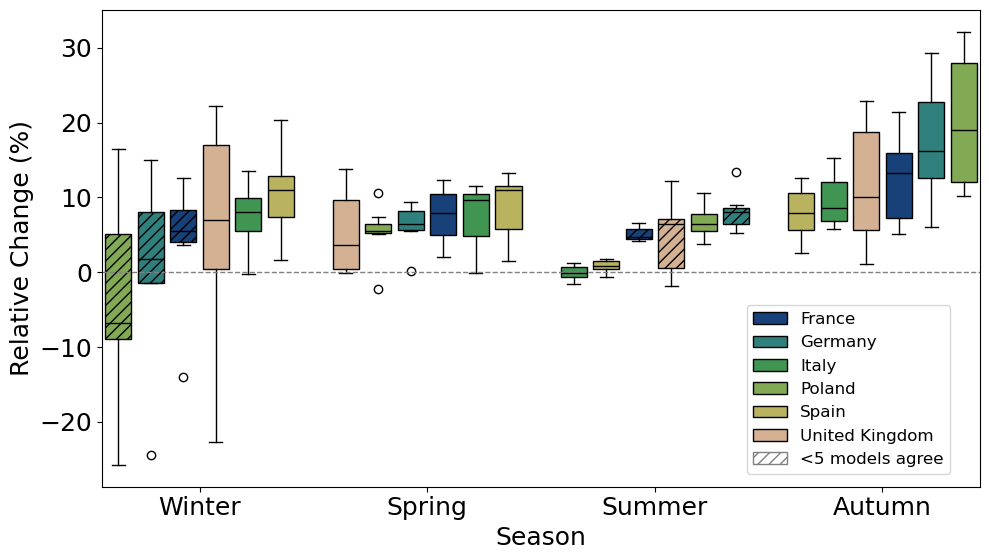

In [66]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# 1) Load & filter
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)

iso2_to_name = {
    "ES":"Spain","IT":"Italy","DE":"Germany",
    "GB":"United Kingdom","FR":"France","PL":"Poland"
}
df = df[
    df['season'].isin(["Winter","Spring","Summer","Autumn"]) &
    df['ISO_A2'].isin(iso2_to_name)
].copy()
df['country'] = df['ISO_A2'].map(iso2_to_name)

# 2) Compute per‐model seasonal means
mean_df = (
    df
    .groupby(['country','season','model','period'])['power']
    .mean()
    .reset_index(name='mean_power')
)

# 3) Pivot to get BOC vs EOC
pivot = (
    mean_df
    .pivot_table(
        index=['country','season','model'],
        columns='period',
        values='mean_power'
    )
    .dropna()
    .reset_index()
)
pivot['rel_change'] = 100*(pivot['ssp585'] - pivot['historical'])/pivot['historical']

# 4) Prepare grouping
seasons = ["Winter","Spring","Summer","Autumn"]
n_countries = len(iso2_to_name)
gap = 1  # gap between season groups
width = 0.8

all_data = []
positions = []
all_colors = []

# get a rainbow palette for the six countries
import seaborn as sns
countries_full = sorted(iso2_to_name.values())  # alphabetical
palette = sns.color_palette("gist_earth", n_countries)
color_map = dict(zip(countries_full, palette))

for i, season in enumerate(seasons):
    sub = pivot[pivot.season == season]
    # sort countries by median rel_change
    order = sub.groupby("country")['rel_change'].median().sort_values().index.tolist()
    # starting x
    start = i*(n_countries+gap)
    for j, country in enumerate(order):
        data = sub[sub.country==country]['rel_change'].values
        all_data.append(data)
        positions.append(start + j)
        all_colors.append(color_map[country])

# 5) Plot with Matplotlib boxplot
fig, ax = plt.subplots(figsize=(10,6))
bp = ax.boxplot(
    all_data,
    positions=positions,
    widths=width,
    patch_artist=True
)

# color each box
for patch, c in zip(bp['boxes'], all_colors):
    patch.set_facecolor(c)
    patch.set_edgecolor('k')
# Set the median lines to black
for median in bp['medians']:
    median.set_color('black')
# color whiskers/caps/medians the same
#for idx, c in enumerate(all_colors):
 #   for part in (
  #      bp['whiskers'][2*idx:2*idx+2] +
   #     bp['caps'][2*idx:2*idx+2] +
    #    [bp['medians'][idx]]
    #):
     #   part.set(color=c, linewidth=1.5)

# 6) Apply hatch to exactly those six boxes:
# Summer: Spain, Italy, United Kingdom
# Winter: France, Germany, Poland
hatch = '///'
# compute the flat indices
for season, targets in [("Summer", ["Spain","Italy","United Kingdom"]),
                        ("Winter", ["France","Germany","Poland"])]:
    sec_idx = seasons.index(season)
    sub = pivot[pivot.season==season]
    order = sub.groupby("country")['rel_change'].median().sort_values().index.tolist()
    start = sec_idx*(n_countries+gap)
    for country in targets:
        j = order.index(country)
        bp['boxes'][start + j].set_hatch(hatch)

# 7) Draw x‐ticks at group centers
centers = [i*(n_countries+gap) + (n_countries-1)/2 for i in range(len(seasons))]
ax.set_xticks(centers)
ax.set_xticklabels(seasons, fontsize=18)
ax.axhline(0, color='gray', linestyle='--', linewidth=1)
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)

ax.set_xlabel("Season", fontsize=18)
ax.set_ylabel("Relative Change (%)", fontsize=18)

# 8) Legend: countries + hatch

handles = [Patch(facecolor=palette[i], edgecolor='k', label=countries_full[i])
           for i in range(n_countries)]
handles.append(Patch(facecolor='none', hatch=hatch, edgecolor='gray', label='<5 models agree'))
labels = [h.get_label() for h in handles]

fig.subplots_adjust(bottom=0.2)
ax.legend(
    handles, labels,
    loc='lower center',
    bbox_to_anchor=(0.85, 0.01),
    ncol=1,
    frameon=True, prop={'size': 12}
)

plt.tight_layout(rect=[0,0.05,1,1])
plt.show()


/tmp/ipykernel_4824/3323917948.py:64: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bp = ax.boxplot(


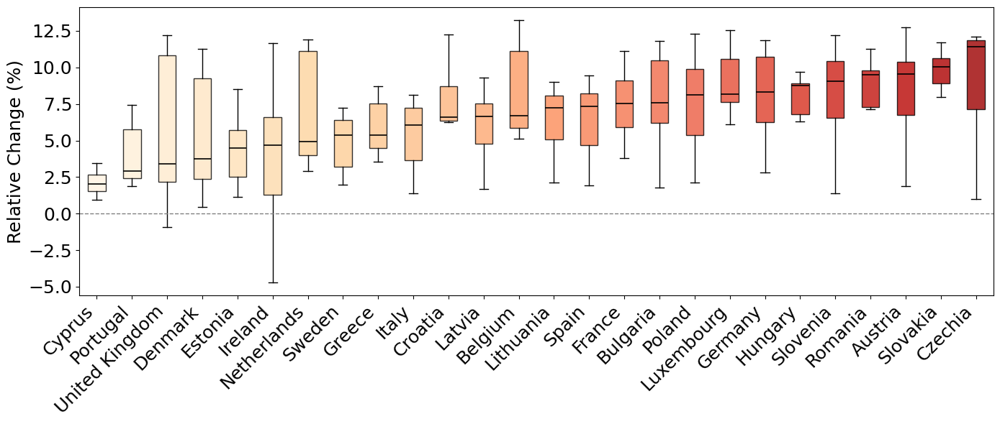

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pycountry
import matplotlib as mpl

# 1) Load & prepare data
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/solar_country_model_stats.csv"
df = pd.read_csv(csv_path)
df['median_BOC'] = pd.to_numeric(df['median_BOC'], errors='coerce')
df['median_EOC'] = pd.to_numeric(df['median_EOC'], errors='coerce')
df['rel_change'] = 100 * (df['median_EOC'] - df['median_BOC']) / df['median_BOC']

# 2) Filter to EU27 + UK
EU27 = [
    'AT','BE','BG','HR','CZ','DK','EE','FR','DE','GR',
    'HU','IE','IT','LV','LT','LU','NL','PL','PT','RO',
    'SK','SI','ES','SE','CY'
]
EU27pUK = EU27 + ['GB']
df_eu = df[df['ISO_A2'].isin(EU27pUK)].copy()

# 3) Compute per‐country means & sort
means = df_eu.groupby('ISO_A2')['rel_change'].median()
sorted_isos = means.sort_values().index.tolist()   # length 28
#sorted_isos = df_eu['ISO_A2'].unique().tolist()
# 4) Map ISO2 → country name for x‐labels
iso2_to_name = {c.alpha_2: c.name for c in pycountry.countries}
labels = [iso2_to_name.get(iso, iso) for iso in sorted_isos]

# 5) Gather data arrays in sorted order
data = [df_eu.loc[df_eu['ISO_A2']==iso, 'rel_change'].values
        for iso in sorted_isos]

# 1) Create an HLS palette of length = number of ISO codes
#n = len(sorted_isos)   # e.g. 28
#palette = sns.hls_palette(
 #   n_colors=n,
  #  h=0.0,    # start at red
   # l=0.65,   # moderate lightness
    #s=0.75    # moderate saturation
#)
n = len(sorted_isos)   # e.g. 28
pal1 = sns.color_palette("tab20", 20)
pal2 = sns.color_palette("tab20b", 7)

# 2) Concatenate to 27
palette = pal1 + pal2

pal1 = sns.color_palette("gist_earth", 20)
pal2 = sns.color_palette("gnuplot", 7)

# 2) Concatenate to 27
palette = pal1 + pal2
palette = sns.color_palette("OrRd", 27)


# 2) Map ISO code → color
iso_to_color = dict(zip(sorted_isos, palette))

# 7) Draw the boxplot
fig, ax = plt.subplots(figsize=(14, 6))
bp = ax.boxplot(
    data,
    patch_artist=True,
    showfliers=False,
    labels=labels,
    widths=0.5,
    medianprops=dict(color='black', linewidth=1.2)
)

# 8) Color each box according to its ISO’s HUSL color
for patch, iso in zip(bp['boxes'], sorted_isos):
    patch.set_facecolor(iso_to_color[iso])
    patch.set_edgecolor('black')
    patch.set_alpha(0.8)

# 9) Zero line and formatting
ax.set_xlim(0.5, len(data) + 0.5)
ax.axhline(0, color='gray', linestyle='--', linewidth=1)
ax.set_ylabel("Relative Change (%)", fontsize=18)
ax.tick_params(axis='y', labelsize=18)
ax.set_xticklabels(labels, rotation=45, ha='right', fontsize=18)
plt.tight_layout()
plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/yearly_boxplot_power_husl.pdf", bbox_inches='tight', dpi=300)



In [6]:
df

,ISO_A2,model,median_BOC,median_EOC,rel_change_%,p_shapiro_BOC,p_shapiro_EOC,p_ttest,signif_ttest,rel_change
0,AT,ACCESS-CM2,10831.326007,11864.464398,9.538429,0.279812,0.610097,9.549806e-11,True,9.538429
1,AT,CanESM5,11153.948360,11364.134450,1.884410,0.659840,0.016926,3.815512e-01,False,1.884410
2,AT,CMCC-CM2-SR5,7490.138456,8445.683712,12.757378,0.901629,0.001150,2.870545e-10,True,12.757378
3,AT,CMCC-ESM2,7633.101278,8382.816161,9.821891,0.563644,0.453339,2.521666e-09,True,9.821891
4,AT,HadGEM3-GC31-LL,10735.540230,11909.268123,10.933105,0.536771,0.468478,3.861233e-20,True,10.933105
...,...,...,...,...,...,...,...,...,...,...
282,XK,CMCC-CM2-SR5,1008.307263,1138.131888,12.875502,0.108685,0.302041,1.114667e-11,True,12.875502
283,XK,CMCC-ESM2,1007.014960,1142.104075,13.414807,0.943486,0.297326,4.581789e-11,True,13.414807
284,XK,HadGEM3-GC31-LL,1404.280196,1495.825769,6.519039,0.565095,0.537776,1.380999e-12,True,6.519039
285,XK,HadGEM3-GC31-MM,1376.077100,1453.730392,5.643092,0.709043,0.920505,5.780614e-09,True,5.643092


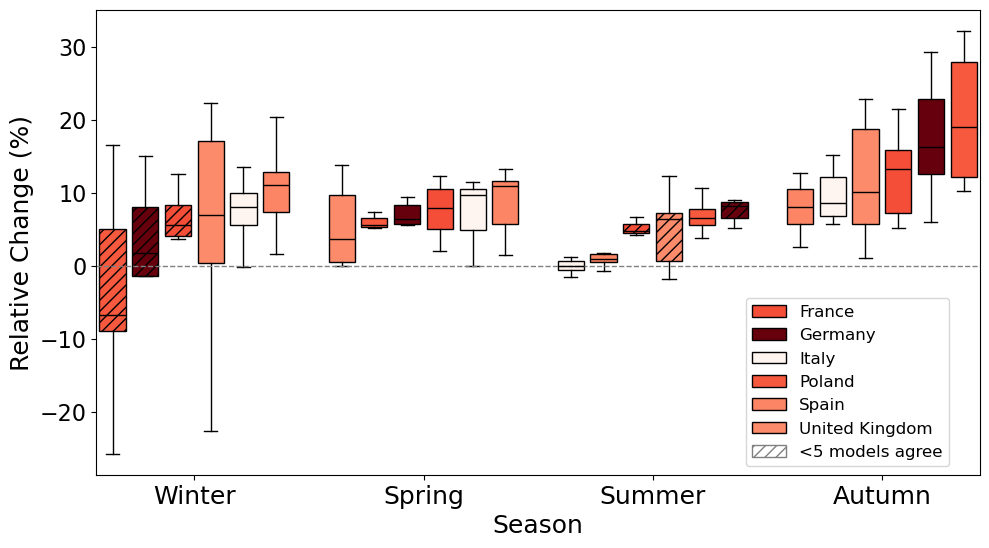

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import matplotlib as mpl
import seaborn as sns

# 1) Load & filter
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)

# focus on the six you care about:
iso2_to_name = {
    "ES":"Spain","IT":"Italy","DE":"Germany",
    "GB":"United Kingdom","FR":"France","PL":"Poland"
}
df = df[
    df['season'].isin(["Winter","Spring","Summer","Autumn"]) &
    df['ISO_A2'].isin(iso2_to_name)
].copy()
df['country'] = df['ISO_A2'].map(iso2_to_name)

# 2) Compute per-model seasonal means and then relative change BOC→EOC
mean_df = (
    df
    .groupby(['country','season','model','period'])['power']
    .mean()
    .reset_index(name='mean_power')
)
pivot = (
    mean_df
    .pivot_table(
        index=['country','season','model'],
        columns='period',
        values='mean_power'
    )
    .dropna()
    .reset_index()
)
pivot['rel_change'] = 100*(pivot['ssp585'] - pivot['historical'])/pivot['historical']

# 3) Prepare colour-ramp from Reds, based on each country’s overall mean annual rel_change
annual_means = pivot.groupby("country")['rel_change'].median()
cmap = plt.get_cmap('Reds')
norm = mpl.colors.Normalize(vmin=annual_means.min(), vmax=annual_means.max())

# map each country → its shade
country_colors = { c: cmap(norm(annual_means[c])) for c in annual_means.index }

# 4) build boxplot data by season + sorted order within each season
seasons = ["Winter","Spring","Summer","Autumn"]
n = len(seasons)
nc = len(annual_means)
gap = 1
width = 0.8

all_data, positions, colors = [], [], []
for i, season in enumerate(seasons):
    sub = pivot[pivot.season==season]
    # sort countries by their median seasonal rel_change
    order = sub.groupby("country")['rel_change'].median().sort_values().index
    base = i*(nc+gap)
    for j, country in enumerate(order):
        all_data .append(sub.loc[sub.country==country,'rel_change'].values)
        positions.append(base + j)
        colors   .append(country_colors[country])

# 5) draw
fig, ax = plt.subplots(figsize=(10,6))
bp = ax.boxplot(
    all_data,
    positions=positions,
    widths=width,
    patch_artist=True,
    showfliers=False
)

# colour boxes
for box, c in zip(bp['boxes'], colors):
    box.set_facecolor(c)
    box.set_edgecolor('k')
# median lines black
for m in bp['medians']:
    m.set_color('k')

# 6) hatch exactly those groups:
hatch = '///'
for season, targets in [("Summer", ["Spain","Italy","United Kingdom"]),
                        ("Winter", ["France","Germany","Poland"])]:
    idx = seasons.index(season)
    sub = pivot[pivot.season==season]
    order = sub.groupby("country")['rel_change'].median().sort_values().index
    base = idx*(nc+gap)
    for country in targets:
        j = list(order).index(country)
        bp['boxes'][base+j].set_hatch(hatch)

# 7) x-ticks at group centers
centers = [i*(nc+gap) + (nc-1)/2 for i in range(n)]
ax.set_xticks(centers)
ax.set_xticklabels(seasons, fontsize=18)

# zero line + labels
ax.axhline(0, color='gray', linestyle='--', linewidth=1)
ax.set_xlabel("Season", fontsize=18)
ax.set_ylabel("Relative Change (%)", fontsize=18)
ax.tick_params(axis='y', labelsize=16)

# 8) legend: a Patch for each country
handles = [
    Patch(facecolor=country_colors[c], edgecolor='k', label=c)
    for c in sorted(annual_means.index)
]
handles.append(Patch(facecolor='none', hatch=hatch,
                     edgecolor='gray', label='<5 models agree'))

ax.legend(
    handles, [h.get_label() for h in handles],
    loc='lower center',
    bbox_to_anchor=(0.85, 0),
    ncol=1, frameon=True,
    prop={'size':12}
)

plt.tight_layout()
plt.subplots_adjust(bottom=0.2)
plt.show()


/tmp/ipykernel_16736/3906233876.py:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap("OrRd", 6)


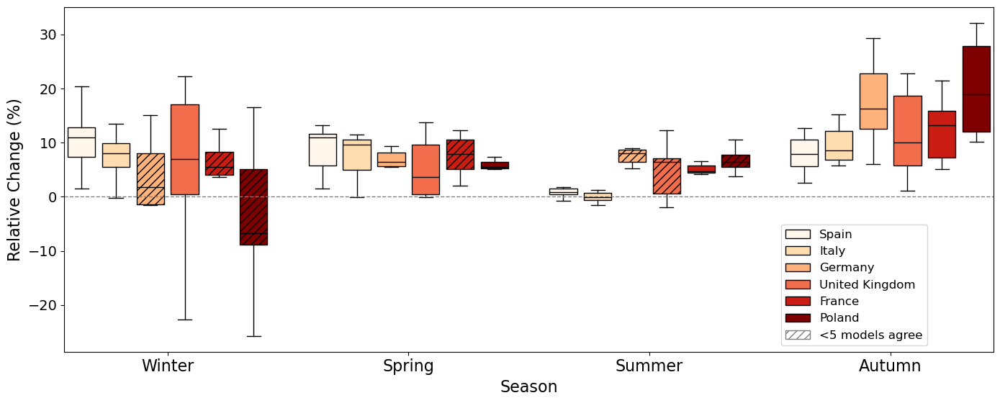

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import matplotlib as mpl
import seaborn as sns

# 1) Load & filter
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)

iso2_to_name = {
    "ES":"Spain","IT":"Italy","DE":"Germany",
    "GB":"United Kingdom","FR":"France","PL":"Poland"
}
df = df[
    df['season'].isin(["Winter","Spring","Summer","Autumn"]) &
    df['ISO_A2'].isin(iso2_to_name)
].copy()
df['country'] = df['ISO_A2'].map(iso2_to_name)

# 2) Compute per-model seasonal means and relative change
mean_df = (
    df
    .groupby(['country','season','model','period'])['power']
    .mean()
    .reset_index(name='mean_power')
)
pivot = (
    mean_df
    .pivot_table(
        index=['country','season','model'],
        columns='period',
        values='mean_power'
    )
    .dropna()
    .reset_index()
)
pivot['rel_change'] = 100*(pivot['ssp585'] - pivot['historical'])/pivot['historical']

# 3) Build the fixed country order and compute overall annual means
countries = ["Spain","Italy","Germany","United Kingdom","France","Poland"]
annual_means = pivot.groupby("country")['rel_change'].mean()

# 4) Build a sober 6-color palette from OrRd
cmap = mpl.cm.get_cmap("OrRd", 6)
country_colors = {c: cmap(i) for i,c in enumerate(countries)}

# 5) Prepare data & positions for the boxplot
seasons = ["Winter","Spring","Summer","Autumn"]
nc = len(countries)
gap = 1
width = 0.8

all_data, positions, colors = [], [], []
for i, season in enumerate(seasons):
    sub = pivot[pivot.season==season]
    base = i*(nc+gap)
    for j, country in enumerate(countries):
        vals = sub.loc[sub.country==country, 'rel_change'].values
        all_data.append(vals)
        positions.append(base + j)
        colors.append(country_colors[country])

# 6) Draw
fig, ax = plt.subplots(figsize=(14,6))
bp = ax.boxplot(
    all_data,
    positions=positions,
    widths=width,
    patch_artist=True,
    showfliers=False
)

# 7) Color each box by our fixed palette
for patch, country in zip(bp['boxes'], [c for _ in seasons for c in countries]):
    patch.set_facecolor(country_colors[country])
    patch.set_edgecolor('black')
# medians in black
for m in bp['medians']:
    m.set_color('black')

# 8) Hatch specific boxes
hatch = '///'
for season, targets in [("Summer", ["Spain","Italy","United Kingdom"]),
                        ("Spring", ["United Kingdom"]),
                        ("Winter", ["France","Germany","Poland"])]:
    idx = seasons.index(season)
    base = idx*(nc+gap)
    for country in targets:
        j = countries.index(country)
        bp['boxes'][base + j].set_hatch(hatch)

# 9) Ticks, labels, legend
centers = [i*(nc+gap) + (nc-1)/2 for i in range(len(seasons))]
ax.set_xticks(centers)
ax.set_xticklabels(seasons, fontsize=16)
ax.axhline(0, color='gray', linestyle='--', linewidth=1)
ax.set_xlabel("Season", fontsize=16)
ax.set_ylabel("Relative Change (%)", fontsize=16)
ax.tick_params(axis='y', labelsize=14)

# 10) Legend
handles = [Patch(facecolor=country_colors[c], edgecolor='k', label=c)
           for c in countries]
handles.append(Patch(facecolor='none', hatch=hatch, edgecolor='gray', label='<5 models agree'))
ax.legend(handles, [h.get_label() for h in handles],
          loc='lower center', bbox_to_anchor=(0.85, 0),
          ncol=1, frameon=True, prop={'size':12})

plt.tight_layout(rect=[0,0.05,1,1])
plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/seasonal_boxplot_power.pdf", bbox_inches='tight', dpi=300)
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import matplotlib as mpl
import seaborn as sns
import pycountry

# 1) Create an HLS palette of length = number of ISO codes
n = len(sorted_isos)   # e.g. 28
palette = sns.cubehelix_palette(n, start=0.5, rot=-0.75, dark=0.2, light=0.85)
n = 27  # or len(sorted_isos) if that equals 27
# 1) Create an HLS palette of length = number of ISO codes
pal2 = sns.color_palette("gnuplot", 7)

# 2) Concatenate to 27
palette = pal2

# 2) Map ISO code → color
iso_to_color = dict(zip(sorted_isos, palette))

# ─── PART B: seasonal plot reusing those same six colors ────────────────

# 1) Load & filter
csv_path = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/country_seasonal_and_annual_power_fractional.csv"
df = pd.read_csv(csv_path)

iso2_to_name = {
    "ES":"Spain","IT":"Italy","DE":"Germany",
    "GB":"United Kingdom","FR":"France","PL":"Poland"
}
df = df[
    df['season'].isin(["Winter","Spring","Summer","Autumn"]) &
    df['ISO_A2'].isin(iso2_to_name)
].copy()
df['country'] = df['ISO_A2'].map(iso2_to_name)

# 2) Compute per-model seasonal means and relative change
mean_df = (
    df
    .groupby(['country','season','model','period'])['power']
    .mean()
    .reset_index(name='mean_power')
)
pivot = (
    mean_df
    .pivot_table(
        index=['country','season','model'],
        columns='period',
        values='mean_power'
    )
    .dropna()
    .reset_index()
)
pivot['rel_change'] = 100*(pivot['ssp585'] - pivot['historical'])/pivot['historical']

# 3) Fixed country order
countries = ["Spain","Italy","Germany","United Kingdom","France","Poland"]
six_iso = ['ES','IT','DE','GB','FR','PL']

# 4) Build a 6‐country color mapping by re-using iso_to_color
country_colors = {
    iso2_to_name[iso]: iso_to_color[iso]
    for iso in six_iso
}

# 5) Prepare data & positions
seasons = ["Winter","Spring","Summer","Autumn"]
nc, gap, width = len(countries), 1, 0.8

all_data, positions, colors = [], [], []
for i, season in enumerate(seasons):
    sub = pivot[pivot.season==season]
    base = i*(nc+gap)
    for j, country in enumerate(countries):
        vals = sub.loc[sub.country==country, 'rel_change'].values
        all_data.append(vals)
        positions.append(base + j)
        colors.append(country_colors[country])

# 6) Draw
fig, ax = plt.subplots(figsize=(10,6))
bp = ax.boxplot(
    all_data,
    positions=positions,
    widths=width,
    patch_artist=True,
    showfliers=False
)

# 7) Color each box with the reused palette
for patch, country in zip(bp['boxes'], [c for _ in seasons for c in countries]):
    patch.set_facecolor(country_colors[country])
    patch.set_edgecolor('black')
for m in bp['medians']:
    m.set_color('black')

# 8) Hatch specific boxes
hatch = '///'
for season, targets in [("Summer", ["Spain","Italy","United Kingdom"]),
                        ("Winter", ["France","Germany","Poland"])]:
    idx = seasons.index(season)
    base = idx*(nc+gap)
    for country in targets:
        j = countries.index(country)
        bp['boxes'][base + j].set_hatch(hatch)

# 9) Ticks, labels, legend
centers = [i*(nc+gap) + (nc-1)/2 for i in range(len(seasons))]
ax.set_xticks(centers)
ax.set_xticklabels(seasons, fontsize=16)
ax.axhline(0, color='gray', linestyle='--', linewidth=1)
ax.set_xlabel("Season", fontsize=16)
ax.set_ylabel("Relative Change (%)", fontsize=16)
ax.tick_params(axis='y', labelsize=14)

handles = [
    Patch(facecolor=country_colors[c], edgecolor='k', label=c)
    for c in countries
]
handles.append(Patch(facecolor='none', hatch=hatch,
                     edgecolor='gray', label='<5 models agree'))

ax.legend(handles, [h.get_label() for h in handles],
          loc='lower center', bbox_to_anchor=(0.85, 0),
          ncol=1, frameon=True, prop={'size':12})

plt.tight_layout(rect=[0,0.05,1,1])
plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/seasonal_boxplot_power.pdf", bbox_inches='tight', dpi=300)
plt.show()
plt.show()


KeyError: 'ES'